### Exploring Data and Building a Custom DataLoader

#### 1. Exploring the Dataset

In [1]:
import os
import numpy as np 
from glob import glob 



full_images=glob('/kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba/*.jpg')
indexes=np.arange(len(full_images))

np.random.shuffle(indexes)


sub_images=[full_images[idx]for idx in indexes[:5000]]


print('Number of Images:',len(full_images))
print('Number of Sub-Images:',len(sub_images))

Number of Images: 202599
Number of Sub-Images: 5000


the shape of the image is : (218, 178, 3)


(-0.5, 255.5, 255.5, -0.5)

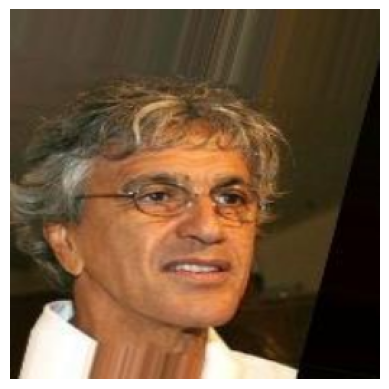

In [2]:
import cv2

import matplotlib.pyplot as plt 

idx=np.random.randint(0,len(sub_images))
image=cv2.imread(sub_images[idx])
image=cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
print('the shape of the image is :',image.shape)
image=cv2.resize(image,(256,256))

plt.imshow(image)
plt.axis('off')



(-0.5, 63.5, 63.5, -0.5)

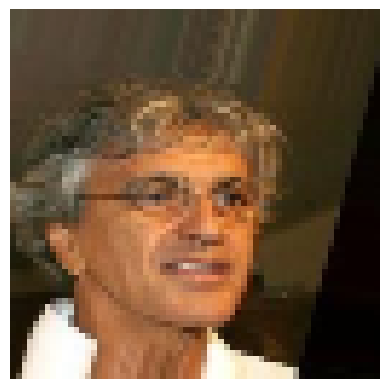

In [3]:
input=cv2.resize(image,(64,64))

plt.imshow(input)
plt.axis('off')

#### 2.Custom Data Loader

In [4]:
import os
import numpy as np
import cv2
from tensorflow.keras.utils import Sequence

class DataGenerator(Sequence):
    def __init__(self, image_names, batch_size=1, img_size=(200,200), scale_factor=4, shuffle=True,*args,**kwargs):
        super(DataGenerator).__init__(*args,**kwargs)
        """
        Data Generator for image data.
        
        Parameters:
            image_names: List of image file names.
            folder: Directory containing the images.
            batch_size: Number of samples per batch.
            img_size: Target size for the high-resolution images.
            scale_factor: Factor by which the image size will be reduced.
            shuffle: Whether to shuffle the dataset after each epoch.
        """
        self.image_names = image_names
        self.batch_size = batch_size
        self.img_size = img_size
        self.scale_factor = scale_factor
        self.shuffle = shuffle
        self.indexes = np.arange(len(self.image_names))
        self.on_epoch_end()

    def __len__(self):
        """
        Number of batches per epoch.
        """
        return int(np.floor(len(self.image_names) / self.batch_size))

    def __getitem__(self, index):
        """
        Generate one batch of data.
        
        Parameters:
            index: Index of the batch.
        
        Returns:
            input_images: Batch of low-resolution images.
            output_images: Batch of high-resolution images.
        """
        start = index * self.batch_size
        end = (index + 1) * self.batch_size
        idxs = self.indexes[start:end]
        return self.load_data(idxs)

    def on_epoch_end(self):
        """
        Shuffle data after each epoch.
        """
        if self.shuffle:
            np.random.shuffle(self.indexes)

    def load_data(self, indexes):
        """
        Load data for a batch of indices.
        
        Parameters:
            indexes: List of indices for the batch.
        
        Returns:
            input_images: Batch of low-resolution images.
            output_images: Batch of high-resolution images.
        """
        input_images = np.zeros((self.batch_size, 
                                 self.img_size[0] // self.scale_factor, 
                                 self.img_size[1] // self.scale_factor, 
                                 3))
        output_images = np.zeros((self.batch_size, 
                                  *self.img_size, 
                                  3))
        
        for i, idx in enumerate(indexes):
            image = cv2.imread(self.image_names[idx])
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = cv2.resize(image, self.img_size)
            
            low_res_image = cv2.resize(image, 
                                       (self.img_size[0] // self.scale_factor, 
                                        self.img_size[1] // self.scale_factor))
            
            input_images[i] = low_res_image / 255.0
            output_images[i] = (image-127.5)/127.5
            
        return input_images, output_images
    
    
    
    
train_gen = DataGenerator(sub_images,batch_size=16,img_size=(256,256))


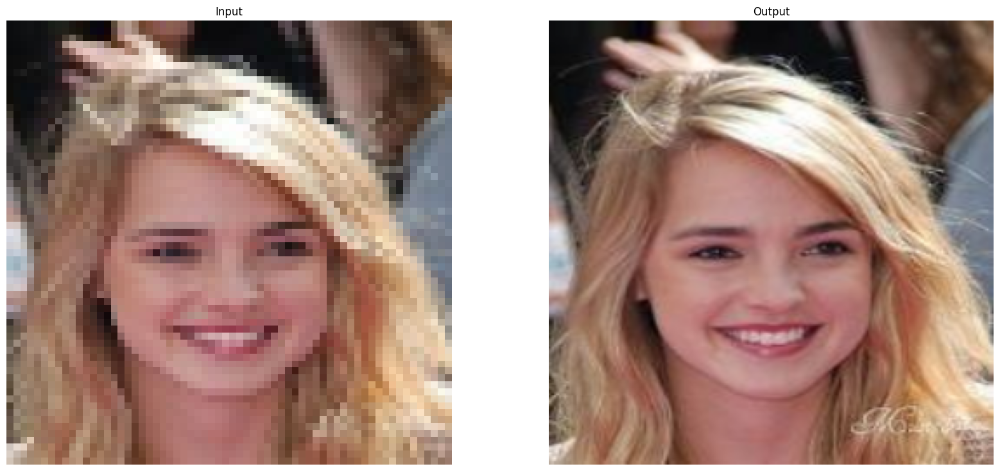

noise image shape : (16, 64, 64, 3)
original image shape : (16, 256, 256, 3)


In [5]:
# Fetch a batch of images from the data generator
inp, out = next(iter(train_gen))

# Create subplots
fig, ax = plt.subplots(1, 2, figsize=(20, 9))

# Display the input image
ax[0].imshow(inp[0])
ax[0].axis('off')  # Turn off axis
ax[0].set_title('Input')

# Display the output image
ax[1].imshow((out[0]+1)/2)
ax[1].axis('off')  # Turn off axis
ax[1].set_title('Output')

plt.show()

print('noise image shape :',inp.shape)
print('original image shape :',out.shape)


### Build Networks:

<img src='https://media.geeksforgeeks.org/wp-content/uploads/20200612003056/generator-660x191.PNG' width='800'/>

### Generator Model Architecture


In [6]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, BatchNormalization, ReLU, Add,PReLU,LeakyReLU,Input,Flatten,Dense

def residual_block(inputs, filters=64, kernel_size=3,use_batchnorm=True):
    """
    Residual block with two convolutional layers.

    Parameters:
        inputs: Input tensor.
        filters: Number of filters in the convolutional layers.
        kernel_size: Size of the convolutional kernel.
        strides: Strides of the convolution.
        use_batchnorm: Whether to use BatchNormalization.
    
    Returns:
        Output tensor after applying the residual block.
    """
    x = Conv2D(filters, kernel_size, strides=1, padding='same')(inputs)
    if use_batchnorm:
        x = BatchNormalization()(x)
    x = ReLU()(x)
    
    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    if use_batchnorm:
        x = BatchNormalization()(x)
    
    x = Add()([inputs, x])  # Skip connection (Residual)
    return x


### Pixel Shuffle Visualization


<img src='https://animatedai.github.io/media/pixel-shuffle-2x2-shuffle.gif' width='600'/>



You can also see more about animated convolutions [here](https://animatedai.github.io/#pixel-shuffle).


In [7]:
import tensorflow as tf

class PixelShuffle(tf.keras.layers.Layer):
    def __init__(self, scale=2, **kwargs):
        """
        Pixel Shuffle (Depth-to-Space) Layer using TensorFlow built-in function.
        
        Parameters:
            scale: Upsampling scale factor. The output will have spatial dimensions
                   increased by this factor.
        """
        super(PixelShuffle, self).__init__(**kwargs)
        self.scale = scale

    def build(self, input_shape):
        """
        Build the layer with error checks.
        
        Parameters:
            input_shape: Shape of the input tensor.
        
        Raises:
            ValueError: If the number of channels is not divisible by scale^2.
        """
        # Ensure the scale factor is a positive integer
        if not isinstance(self.scale, int) or self.scale <= 0:
            raise ValueError(f"Scale factor must be a positive integer. Got: {self.scale}")

        # Extract the number of channels from the input shape
        _, _, _, channels = input_shape

        # Check if channels is divisible by scale^2
        if channels % (self.scale ** 2) != 0:
            raise ValueError(f"The number of channels ({channels}) must be divisible by scale^2 ({self.scale ** 2}).")

    def call(self, inputs):
        """
        Apply Pixel Shuffle operation using tf.nn.depth_to_space.
        
        Parameters:
            inputs: Input tensor of shape (batch_size, height, width, channels).
        
        Returns:
            Output tensor with spatial dimensions increased by `scale` factor.
        """
        return tf.nn.depth_to_space(inputs, block_size=self.scale)

    def compute_output_shape(self, input_shape):
        """
        Compute the output shape of the layer.
        
        Parameters:
            input_shape: Shape of the input tensor.
        
        Returns:
            Output shape of the tensor after applying Pixel Shuffle.
        """
        batch_size, height, width, channels = input_shape
        new_height = height * self.scale
        new_width = width * self.scale
        new_channels = channels // (self.scale ** 2)
        return (batch_size, new_height, new_width, new_channels)

In [8]:
from tensorflow.keras.models import Model

def build_generator(input_shape=(50, 50, 3), num_residual_blocks=16, scale=2):
    """
    Builds the SRGAN generator network with an input size of 75x75x3 and output size of 300x300x3.

    Parameters:
        input_shape: Shape of the input low-resolution image.
        num_residual_blocks: Number of residual blocks to use.
        scale: Upscaling factor for the Pixel Shuffle layer.
    
    Returns:
        A Keras model representing the generator network.
    """
    # Input layer
    inputs = Input(shape=input_shape)

    # Initial convolutional layer
    x = Conv2D(64, (9, 9), strides=(1, 1), padding='same')(inputs)
    x = PReLU(shared_axes=[1, 2])(x)

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x)

    # Second convolutional layer before upsampling
    x = Conv2D(3, (3, 3), strides=(1, 1), padding='same')(x)
    x = BatchNormalization()(x)

    # Adding the skip connection
    x = Add()([x, inputs])

    # Upsampling layers using the custom PixelShuffle layer
    x = Conv2D(256, (3, 3), strides=(1, 1), padding='same')(x)
    x = PixelShuffle(scale=scale)(x)
    x = PReLU(shared_axes=[1, 2])(x)

    # Second upsampling layer
    x = Conv2D(256, (3, 3), strides=(1, 1), padding='same')(x)
    x = PixelShuffle(scale=scale)(x)
    x = PReLU(shared_axes=[1, 2])(x)

    # Output layer (reconstructing the high-resolution image)
    outputs = Conv2D(3, (9, 9), strides=(1, 1), padding='same', activation='tanh')(x)

    # Create the model
    model = Model(inputs, outputs, name='SRGAN_Generator')
    
    return model

# Example usage
generator = build_generator(input_shape=(64,64, 3), num_residual_blocks=8, scale=2)
generator.summary()

Model: "SRGAN_Generator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 64, 64, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 64, 64,    │     15,616 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ p_re_lu (PReLU)     │ (None, 64, 64,    │         64 │ conv2d[0][0]      │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 64, 64,    │     36,928 │ p_re_lu[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 64, 64,    │        256 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 64, 64,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 64,    │     36,928 │ re_lu[0][0]       │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 64, 64,    │          0 │ p_re_lu[0][0],    │
│                     │ 64)               │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │     36,928 │ add[0][0]         │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │     36,928 │ re_lu_1[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_1 (Add)         │ (None, 64, 64,    │          0 │ add[0][0],        │
│                     │ 64)               │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 64, 64,    │     36,928 │ add_1[0][0]       │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv2d_5[0][0]  

 Total params: 782,930 (2.99 MB)

 Trainable params: 780,876 (2.98 MB)

 Non-trainable params: 2,054 (8.02 KB)

<img src='https://media.geeksforgeeks.org/wp-content/uploads/20200618222236/discriminator.PNG' width='800'/>

### Discriminator Model Architecture


In [16]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, LeakyReLU, BatchNormalization, Dense, Flatten,Dropout
from tensorflow.keras import Input, Model

# Utility function for Conv2D with BatchNormalization and LeakyReLU
def conv_block(x, filters, kernel_size=3, strides=1, padding='same', use_bn=True, use_relu=True):
    x = Conv2D(filters, kernel_size=kernel_size, strides=strides, padding=padding, use_bias=not use_bn)(x)
    if use_bn:
        x = BatchNormalization()(x)
    if use_relu:
        x = LeakyReLU(negative_slope=0.2)(x)
        
        
    x=Dropout(.2)(x)
    return x

def build_discriminator(input_shape=(200,200, 3)):
    inputs = Input(shape=input_shape)

    # Define the architecture using conv_block function
    x = conv_block(inputs,32, kernel_size=3, strides=2)
    x = conv_block(x, 32, kernel_size=3, strides=2)
    x = conv_block(x, 64, kernel_size=3, strides=2)
    x = conv_block(x,64, kernel_size=3, strides=2)
    x = conv_block(x,128, kernel_size=3, strides=2)
    x = conv_block(x,128, kernel_size=3, strides=2)

    # Flatten and add Dense layers for final classification
    x = Flatten()(x)
    x = Dense(32)(x)
    x = LeakyReLU(negative_slope=0.2)(x)
    output = Dense(1, activation='sigmoid')(x)

    # Create the model
    model = Model(inputs, output,name='SRGAN_Discriminator')
    return model

# Example usage
discriminator = build_discriminator(input_shape=(256,256, 3))
discriminator.summary()


Model: "SRGAN_Discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 128, 128, 32)   │           864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 128, 128, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_24 (Conv2D)              │ (None, 64, 64, 32)     │         9,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 64, 64, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 32, 32, 64)     │        18,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 16, 16, 64)     │        36,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 16, 16, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 8, 8, 128)      │        73,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 8, 8, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_28 (Conv2D)              │ (None, 4, 4, 128)      │       147,456 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 353,953 (1.35 MB)

 Trainable params: 353,057 (1.35 MB)

 Non-trainable params: 896 (3.50 KB)

In [17]:
### Feature Extractor 
from tensorflow.keras.applications import VGG19

def build_vgg19_feature_extractor(layer_name='block5_conv4', input_shape=(200, 200, 3)):
    """
    Loads a pre-trained VGG19 model and configures it as a feature extractor.

    Parameters:
        layer_name: The layer from which to extract features (default is 'block5_conv4').
        input_shape: The shape of the input images (default is 300x300x3).

    Returns:
        A Keras model that outputs features from the specified layer of VGG19.
    """
    # Load the VGG19 model with pre-trained ImageNet weights, excluding the top fully connected layers.
    vgg19 = VGG19(weights='imagenet', include_top=False, input_shape=input_shape)
    
    # Select the specific layer to extract features from
    feature_extractor = Model(inputs=vgg19.input, outputs=vgg19.get_layer(layer_name).output)
    
    # Set the VGG19 layers to be non-trainable
    feature_extractor.trainable = False
    
    return feature_extractor

# Example usage
vgg19_feature_extractor = build_vgg19_feature_extractor(layer_name='block4_conv2', input_shape=(256, 256, 3))
vgg19_feature_extractor.summary()

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,865,536 (22.38 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 5,865,536 (22.38 MB)

### Custom Trainning Loop:

In [14]:
inp.shape

(1, 64, 64, 3)

In [19]:
inp, out = next(iter(train_gen))


generated_images=generator.predict(inp)



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


In [23]:
generated_images.shape

(1, 256, 256, 3)

In [20]:
featured_fake=vgg19_feature_extractor.predict((generated_images + 1) / 2)

featured_real = vgg19_feature_extractor.predict((out + 1) / 2)

print('fake shape',featured_fake.shape)
print('real shape',featured_real.shape)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
fake shape (1, 32, 32, 512)
real shape (1, 32, 32, 512)


In [21]:
tf.reduce_mean(tf.square(featured_real - featured_fake))

<tf.Tensor: shape=(), dtype=float32, numpy=88.620224>

In [22]:
tf.reduce_mean(tf.abs(featured_real - featured_fake))

<tf.Tensor: shape=(), dtype=float32, numpy=4.6286607>

In [20]:
z=tf.reduce_mean(tf.abs(featured_real - featured_fake))
print(z)

tf.Tensor(0.10576015, shape=(), dtype=float32)


In [70]:
tf.keras.losses.mse(featured_real,featured_fake)

<tf.Tensor: shape=(1, 32, 32), dtype=float32, numpy=
array([[[ 0.07352241,  0.0943392 ,  0.10423233, ...,  0.149196  ,
          0.18755756,  0.12883571],
        [ 0.05586433,  0.04847877,  0.07136841, ...,  0.09691304,
          0.08058225,  0.09947599],
        [ 0.06525181,  0.07172916,  0.11454921, ...,  0.13467264,
          0.13599852,  0.13284227],
        ...,
        [ 7.4562683 ,  6.2283354 ,  3.6179438 , ...,  5.873284  ,
          7.68003   , 14.834055  ],
        [ 1.9902089 ,  1.6497171 ,  1.1949528 , ...,  1.0551411 ,
          1.8490587 ,  4.442023  ],
        [ 1.557574  ,  1.2794605 ,  1.0033158 , ...,  0.81201375,
          1.2744683 ,  1.5983574 ]]], dtype=float32)>

### -----------------------------------------------

In [13]:
import tensorflow as tf

class SRGAN(tf.keras.Model):
    def __init__(self, generator, discriminator, feature_extractor, *args, **kwargs):
        super(SRGAN, self).__init__(*args, **kwargs)
        self.generator = generator
        self.discriminator = discriminator
        self.feature_extractor = feature_extractor

    def compile(self, generator_optimizer, discriminator_optimizer, loss_fn, content_loss_weight=1, adversarial_loss_weight=1e-3):
        super(SRGAN, self).compile()
        self.generator_optimizer = generator_optimizer
        self.discriminator_optimizer = discriminator_optimizer
        self.loss_fn = loss_fn
        self.content_loss_weight = content_loss_weight  # Corrected typo
        self.adversarial_loss_weight = adversarial_loss_weight

    def train_step(self, data):
        low_images, high_images = data
        batch_size = tf.shape(high_images)[0]

        # Train Discriminator
        
        real_labels = tf.ones((batch_size, 1))
        fake_labels = tf.zeros((batch_size, 1))

        with tf.GradientTape() as tape:
            generated_images = self.generator(low_images, training=False)
            real_output = self.discriminator((high_images + 1) / 2, training=True)
            fake_output = self.discriminator((generated_images + 1) / 2, training=True)
            real_loss = self.loss_fn(real_labels, real_output)
            fake_loss = self.loss_fn(fake_labels, fake_output)
            d_loss = (real_loss + fake_loss)/2

        grads = tape.gradient(d_loss, self.discriminator.trainable_variables)
        self.discriminator_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_variables))

        # Train Generator
        with tf.GradientTape() as tape:
            generated_images = self.generator(low_images, training=True)
            fake_output = self.discriminator((generated_images + 1) / 2, training=False)
            adversarial_loss = self.loss_fn(real_labels, fake_output)
            
            featured_generated = self.feature_extractor((generated_images + 1) / 2)
            featured_real = self.feature_extractor((high_images + 1) / 2) 
            
            content_loss = tf.reduce_mean(tf.abs(featured_real - featured_generated))
            
            total_loss = (self.content_loss_weight * content_loss) + (self.adversarial_loss_weight * adversarial_loss)

        grads = tape.gradient(total_loss, self.generator.trainable_variables)
        self.generator_optimizer.apply_gradients(zip(grads, self.generator.trainable_variables))

        return {"d_loss": d_loss, "Content_loss": content_loss, 'adversarial_loss': adversarial_loss, 'gen_loss': total_loss}


### Custom CheckPoint

In [19]:
import numpy as np
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
import os

class GANMonitor(tf.keras.callbacks.Callback):
    def __init__(self, images_names, interval=20):
        super(GANMonitor, self).__init__()
        self.images_names = images_names
        self.indices = np.arange(len(self.images_names))  # Corrected spelling to "indices"
        np.random.shuffle(self.indices)  # Shuffle only once during initialization
        self.interval = interval
        self.path = '/kaggle/working/showed_image'
        if not os.path.exists(self.path):
            os.makedirs(self.path)
        self.current_index = 0  # To keep track of the current index in the shuffled list

    def psnr(self, img1, img2):
        mse = np.mean((img1 - img2) ** 2)
        if mse == 0:
            return 100  # Perfect match
        max_pixel = 1.0  # Since images are normalized between 0 and 1
        psnr = 10 * np.log10((max_pixel ** 2) / mse)
        return psnr

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.interval == 0:
            # Select a new image using the shuffled indices
            if self.current_index >= len(self.indices):
                np.random.shuffle(self.indices)  # Shuffle again when all images have been used
                self.current_index = 0  # Reset the index tracker

            idx = self.indices[self.current_index]
            self.current_index += 1

            image = cv2.imread(self.images_names[idx])
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
            hr_image = cv2.resize(image, (256, 256)) / 255.0  # High-resolution image normalized to [0, 1]
            lr_image = cv2.resize(image, (64, 64)) / 255.0  # Low-resolution image normalized to [0, 1]

            # Generate the image using the generator model
            generated_image = self.model.generator(np.expand_dims(lr_image, axis=0))[0]
            generated_image = (generated_image + 1.0) / 2.0  # Convert generated image to [0, 1] range

            # Calculate PSNR between the generated and high-resolution images
            psnr_value = self.psnr(generated_image, hr_image)

            # Plot the low-res, generated, and high-res images
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 3, 1)
            plt.title("Low Resolution")
            plt.imshow(lr_image)
            plt.axis('off')

            plt.subplot(1, 3, 2)
            plt.title(f"Generated Image\nPSNR: {psnr_value:.2f} dB")
            plt.imshow(generated_image)
            plt.axis('off')

            plt.subplot(1, 3, 3)
            plt.title("High Resolution")
            plt.imshow(hr_image)
            plt.axis('off')

            # Save the figure
            plt.savefig(f"{self.path}/image_epoch_{epoch + 1}.png", bbox_inches='tight', dpi=300)

            # Show the plot
            plt.show()


In [20]:
class Custom_CheckPoint(tf.keras.callbacks.Callback):
    def __init__(self, save_interval=5):
        super(Custom_CheckPoint, self).__init__()
        self.save_interval = save_interval
        self.last_generator_checkpoint = None
        self.last_discriminator_checkpoint = None
        self.path='/kaggle/working/models'
        if not os.path.exists(self.path):
                os.makedirs(self.path)

    def on_epoch_end(self, epoch, logs=None):
        # Check if the current epoch is a multiple of the save_interval
        if (epoch + 1) % self.save_interval == 0:
            G_checkpoint_path = os.path.join(self.path,f'generator_epoch_{epoch + 1}.h5')
            D_checkpoint_path = os.path.join(self.path,f'discriminator_epoch_{epoch + 1}.h5')

            # Save the current model checkpoint
            self.model.generator.save(G_checkpoint_path)
            self.model.discriminator.save(D_checkpoint_path)
            print(f'\nSaved checkpoints')

            # Delete the previous checkpoint, if it exists
            if self.last_generator_checkpoint and os.path.exists(self.last_generator_checkpoint)and os.path.exists(self.last_discriminator_checkpoint):
                os.remove(self.last_generator_checkpoint)
                os.remove(self.last_discriminator_checkpoint)
                print(f'Deleted previous checkpoint: {self.last_generator_checkpoint} and {self.last_discriminator_checkpoint}')

            # Update the last_checkpoint to the current checkpoint
            self.last_generator_checkpoint = G_checkpoint_path
            self.last_discriminator_checkpoint=D_checkpoint_path

## Training:
### Warming Up the Generator in SRGAN

Warming up the generator in SRGAN (Super-Resolution Generative Adversarial Network) is a crucial step to stabilize the training process before commencing the full GAN training. This involves initially training the generator independently, without involving the discriminator. The objective is to allow the generator to produce reasonable outputs before entering the adversarial training phase, where both the generator and discriminator are trained together.

#### Purpose of Warming Up the Generator

If the generator starts with completely random outputs, the discriminator can easily distinguish between real and generated images. This can result in a strong gradient, potentially destabilizing the training process. Warming up the generator helps in mitigating this issue.


#### Practical Tips

- **Duration of Warm-Up**: The number of warm-up epochs typically ranges from 5 to 10, depending on the dataset complexity and model requirements.
- **Monitoring**: Regularly monitor the generator's outputs during the warm-up to ensure it produces relatively realistic high-resolution images before introducing the discriminator.

Warming up the generator in this manner contributes to a more stable and effective training process, ultimately leading to better performance of the SRGAN model.


In [11]:
## Warm Up Generator:
from tensorflow.keras.optimizers import Adam


generator.compile(optimizer=Adam(learning_rate=1e-4),loss='MSE',metrics=['accuracy'])

generator.fit(train_gen,steps_per_epoch=len(train_gen),epochs=20)

Epoch 1/20


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1726227496.122528     107 service.cc:145] XLA service 0x786358002340 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1726227496.122625     107 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
2024-09-13 11:38:29.902041: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng20{k2=2,k3=0} for conv (f32[3,64,9,9]{3,2,1,0}, u8[0]{0}) custom-call(f32[16,64,256,256]{3,2,1,0}, f32[16,3,256,256]{3,2,1,0}), window={size=9x9 pad=4_4x4_4}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBac

312/312 ━━━━━━━━━━━━━━━━━━━━ 93s 206ms/step - accuracy: 0.7615 - loss: 0.1256
Epoch 2/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 69us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 3/20


/opt/conda/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


312/312 ━━━━━━━━━━━━━━━━━━━━ 65s 206ms/step - accuracy: 0.8128 - loss: 0.0206
Epoch 4/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 23us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 5/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 65s 206ms/step - accuracy: 0.8278 - loss: 0.0156
Epoch 6/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 23us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 7/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 65s 206ms/step - accuracy: 0.8352 - loss: 0.0121
Epoch 8/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 25us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 9/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 65s 206ms/step - accuracy: 0.8460 - loss: 0.0105
Epoch 10/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 24us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 11/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 65s 206ms/step - accuracy: 0.8534 - loss: 0.0091
Epoch 12/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 25us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 13/20
312/312 ━━━━━━━━━━━━━━━━━━━━ 65s 206ms/step - accuracy: 0.8529 - loss: 0.007

Epoch 1/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 186s 410ms/step - Content_loss: 1.4800 - adversarial_loss: 0.7138 - d_loss: 0.7006 - gen_loss: 1.4807
Epoch 2/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 1.2925 - adversarial_loss: 2.3931 - d_loss: 0.2682 - gen_loss: 1.2949
Epoch 3/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.2211 - adversarial_loss: 1.4590 - d_loss: 0.0811 - gen_loss: 1.2225
Epoch 4/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.1802 - adversarial_loss: 0.5113 - d_loss: 0.0142 - gen_loss: 1.1807
Epoch 5/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 1.1515 - adversarial_loss: 0.4431 - d_loss: 0.0067 - gen_loss: 1.1520

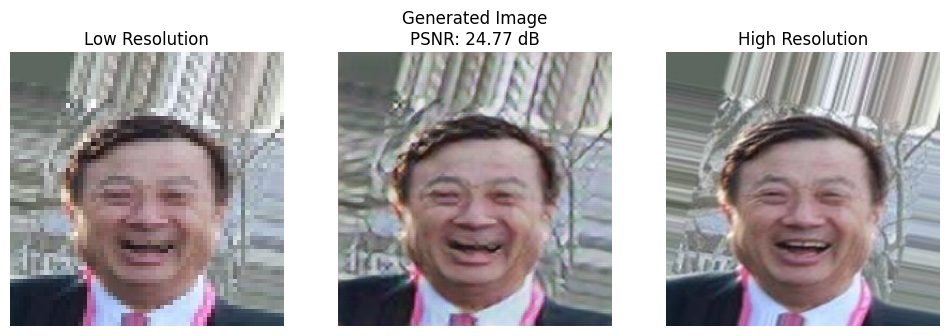


Saved checkpoints
312/312 ━━━━━━━━━━━━━━━━━━━━ 130s 417ms/step - Content_loss: 1.1516 - adversarial_loss: 0.4418 - d_loss: 0.0067 - gen_loss: 1.1521
Epoch 6/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.1323 - adversarial_loss: 0.1270 - d_loss: 0.0014 - gen_loss: 1.1324
Epoch 7/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.1161 - adversarial_loss: 0.1528 - d_loss: 5.1140e-04 - gen_loss: 1.1163
Epoch 8/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.1019 - adversarial_loss: 0.1249 - d_loss: 4.8157e-04 - gen_loss: 1.1020
Epoch 9/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0906 - adversarial_loss: 0.4091 - d_loss: 0.0351 - gen_loss: 1.0910
Epoch 10/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 1.0818 - adversarial_loss: 0.3177 - d_loss: 0.0012 - gen_loss: 1.0821

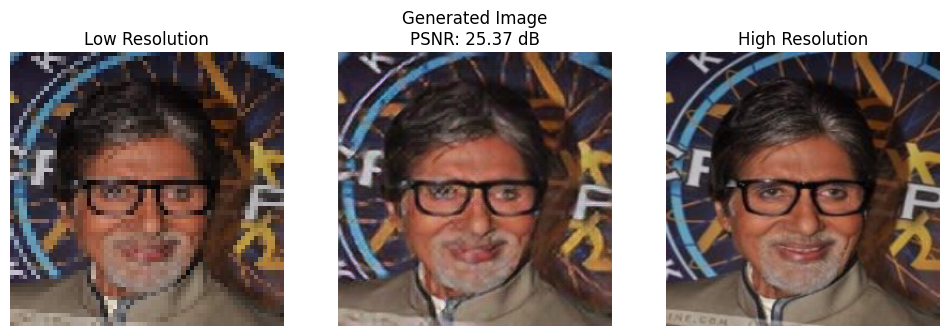


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_5.h5 and /kaggle/working/models/discriminator_epoch_5.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 414ms/step - Content_loss: 1.0818 - adversarial_loss: 0.3179 - d_loss: 0.0012 - gen_loss: 1.0821
Epoch 11/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0726 - adversarial_loss: 0.2505 - d_loss: 7.4119e-04 - gen_loss: 1.0729
Epoch 12/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0624 - adversarial_loss: 0.3081 - d_loss: 0.0014 - gen_loss: 1.0627
Epoch 13/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0596 - adversarial_loss: 0.9121 - d_loss: 0.0239 - gen_loss: 1.0605
Epoch 14/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0524 - adversarial_loss: 0.6124 - d_loss: 0.0013 - gen_loss: 1.0530
Epoch 15/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step - Content_loss: 1.0449 - adversarial_loss: 1.4560 - d_loss: 0.0276 - gen_loss: 1.0464

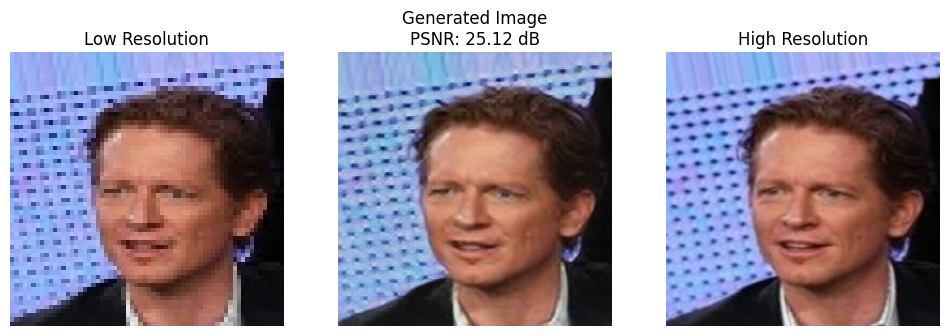


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_10.h5 and /kaggle/working/models/discriminator_epoch_10.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 130s 414ms/step - Content_loss: 1.0448 - adversarial_loss: 1.4529 - d_loss: 0.0276 - gen_loss: 1.0462
Epoch 16/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0364 - adversarial_loss: 0.8058 - d_loss: 0.0010 - gen_loss: 1.0372
Epoch 17/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0321 - adversarial_loss: 0.7181 - d_loss: 4.5148e-04 - gen_loss: 1.0328
Epoch 18/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0278 - adversarial_loss: 0.4801 - d_loss: 3.0768e-04 - gen_loss: 1.0283
Epoch 19/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0253 - adversarial_loss: 0.5252 - d_loss: 1.5496e-04 - gen_loss: 1.0258
Epoch 20/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 1.0185 - adversarial_loss: 0.5112 - d_loss: 1.1287e-04 - gen_lo

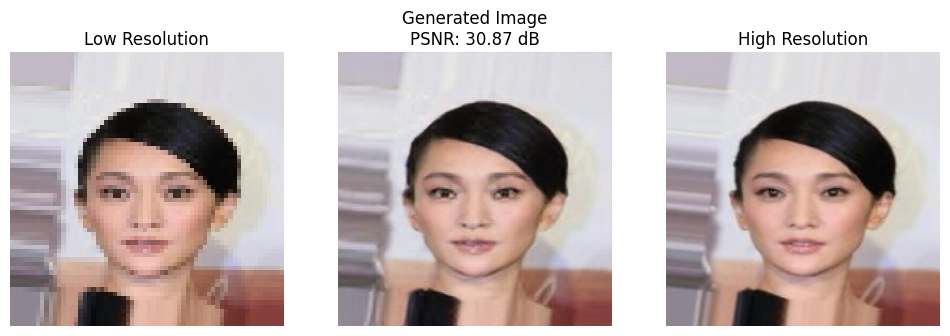


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_15.h5 and /kaggle/working/models/discriminator_epoch_15.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 1.0184 - adversarial_loss: 0.5109 - d_loss: 1.1254e-04 - gen_loss: 1.0189
Epoch 21/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0123 - adversarial_loss: 0.3502 - d_loss: 1.1925e-04 - gen_loss: 1.0126
Epoch 22/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 1.0095 - adversarial_loss: 0.3843 - d_loss: 1.0324e-04 - gen_loss: 1.0099
Epoch 23/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0057 - adversarial_loss: 0.4037 - d_loss: 2.7865e-05 - gen_loss: 1.0061
Epoch 24/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 1.0029 - adversarial_loss: 0.3529 - d_loss: 1.9438e-05 - gen_loss: 1.0033
Epoch 25/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9970 - adversarial_loss: 0.7400 - d_loss: 1.1841e-04 

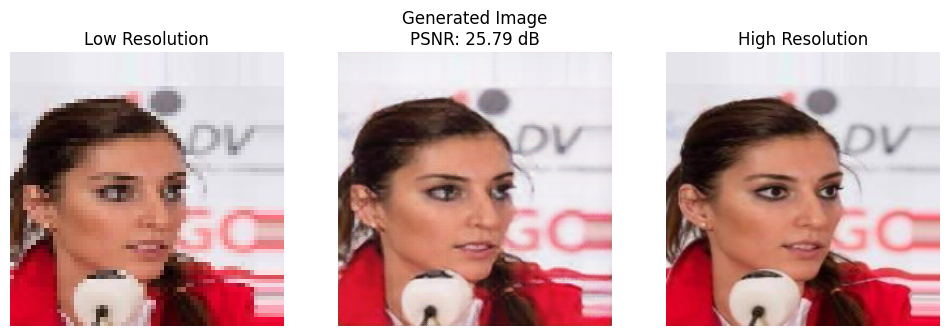


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_20.h5 and /kaggle/working/models/discriminator_epoch_20.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9965 - adversarial_loss: 0.7464 - d_loss: 1.1804e-04 - gen_loss: 0.9973
Epoch 26/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9942 - adversarial_loss: 2.3486 - d_loss: 0.0940 - gen_loss: 0.9965
Epoch 27/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9913 - adversarial_loss: 1.7265 - d_loss: 0.0265 - gen_loss: 0.9930
Epoch 28/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9890 - adversarial_loss: 1.4360 - d_loss: 9.8898e-04 - gen_loss: 0.9904
Epoch 29/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9846 - adversarial_loss: 1.3306 - d_loss: 5.8142e-04 - gen_loss: 0.9859
Epoch 30/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9816 - adversarial_loss: 0.6689 - d_loss: 4.7097e-04 - gen_lo

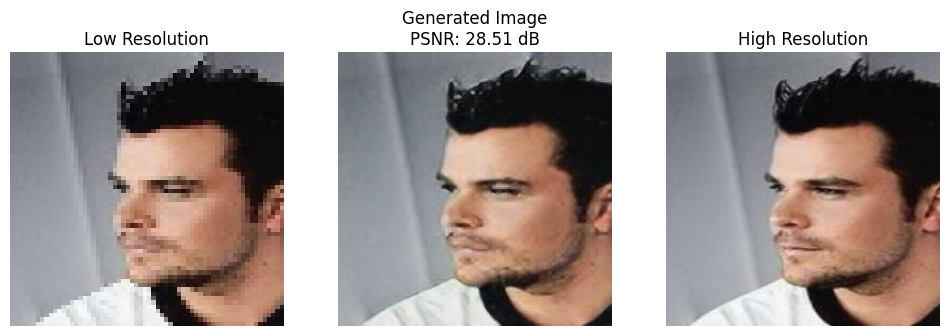


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_25.h5 and /kaggle/working/models/discriminator_epoch_25.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9816 - adversarial_loss: 0.6699 - d_loss: 4.6948e-04 - gen_loss: 0.9823
Epoch 31/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9789 - adversarial_loss: 1.1459 - d_loss: 2.7565e-04 - gen_loss: 0.9800
Epoch 32/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9770 - adversarial_loss: 0.7594 - d_loss: 8.2371e-05 - gen_loss: 0.9778
Epoch 33/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9726 - adversarial_loss: 0.8264 - d_loss: 5.0697e-05 - gen_loss: 0.9734
Epoch 34/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9693 - adversarial_loss: 0.6867 - d_loss: 3.5574e-05 - gen_loss: 0.9700
Epoch 35/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9683 - adversarial_loss: 0.8161 - d_loss: 4.4193e-05 

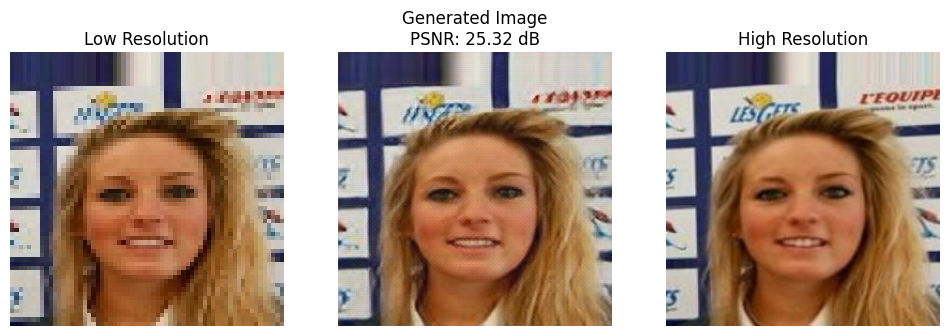


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_30.h5 and /kaggle/working/models/discriminator_epoch_30.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9684 - adversarial_loss: 0.8180 - d_loss: 4.4066e-05 - gen_loss: 0.9693
Epoch 36/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9647 - adversarial_loss: 0.8381 - d_loss: 3.6046e-05 - gen_loss: 0.9655
Epoch 37/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9625 - adversarial_loss: 0.6228 - d_loss: 3.5874e-05 - gen_loss: 0.9631
Epoch 38/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9623 - adversarial_loss: 0.7171 - d_loss: 3.5019e-05 - gen_loss: 0.9630
Epoch 39/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9569 - adversarial_loss: 0.6875 - d_loss: 4.1763e-05 - gen_loss: 0.9575
Epoch 40/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9559 - adversarial_loss: 0.4582 - d_loss: 1.3631e-05 

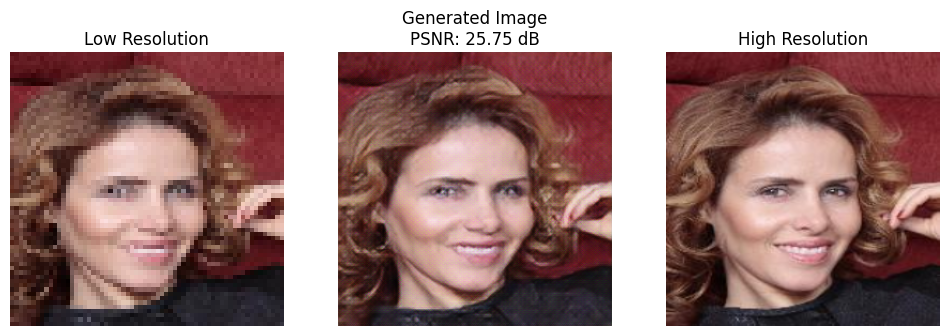


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_35.h5 and /kaggle/working/models/discriminator_epoch_35.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9562 - adversarial_loss: 0.4587 - d_loss: 1.3592e-05 - gen_loss: 0.9567
Epoch 41/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9534 - adversarial_loss: 0.6944 - d_loss: 2.4728e-05 - gen_loss: 0.9541
Epoch 42/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9494 - adversarial_loss: 0.5669 - d_loss: 2.8513e-05 - gen_loss: 0.9500
Epoch 43/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9468 - adversarial_loss: 0.6721 - d_loss: 2.1850e-05 - gen_loss: 0.9475
Epoch 44/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9466 - adversarial_loss: 1.3032 - d_loss: 7.3311e-05 - gen_loss: 0.9479
Epoch 45/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9441 - adversarial_loss: 1.6517 - d_loss: 0.0493 - ge

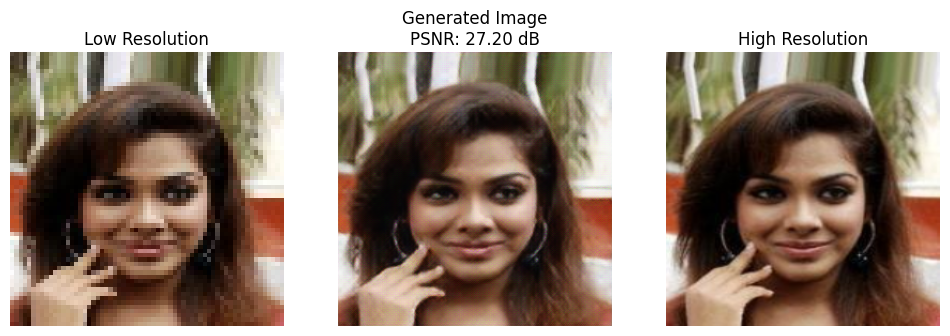


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_40.h5 and /kaggle/working/models/discriminator_epoch_40.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9440 - adversarial_loss: 1.6498 - d_loss: 0.0491 - gen_loss: 0.9457
Epoch 46/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9414 - adversarial_loss: 0.8123 - d_loss: 3.5833e-04 - gen_loss: 0.9422
Epoch 47/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9390 - adversarial_loss: 0.5109 - d_loss: 2.2848e-04 - gen_loss: 0.9395
Epoch 48/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9379 - adversarial_loss: 0.6674 - d_loss: 3.1356e-04 - gen_loss: 0.9386
Epoch 49/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9365 - adversarial_loss: 0.6464 - d_loss: 3.7508e-04 - gen_loss: 0.9371
Epoch 50/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9344 - adversarial_loss: 0.6154 - d_loss: 1.4417e-04 - ge

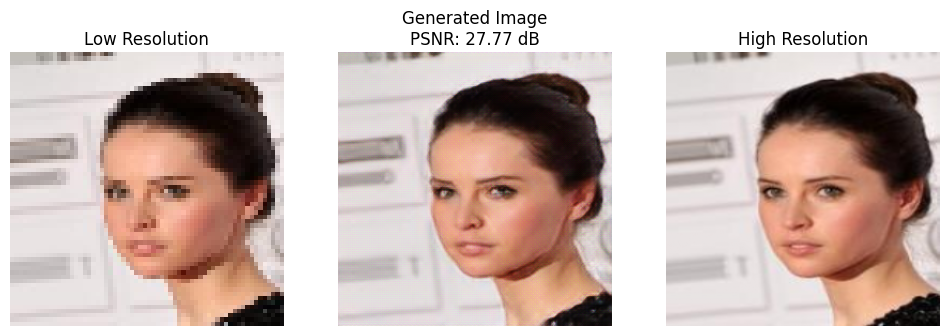


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_45.h5 and /kaggle/working/models/discriminator_epoch_45.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9343 - adversarial_loss: 0.6149 - d_loss: 1.4376e-04 - gen_loss: 0.9350
Epoch 51/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9314 - adversarial_loss: 0.9628 - d_loss: 5.3787e-04 - gen_loss: 0.9324
Epoch 52/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9310 - adversarial_loss: 0.2997 - d_loss: 1.0435e-05 - gen_loss: 0.9313
Epoch 53/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9276 - adversarial_loss: 0.3731 - d_loss: 9.4002e-06 - gen_loss: 0.9280
Epoch 54/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9241 - adversarial_loss: 0.6777 - d_loss: 1.3331e-05 - gen_loss: 0.9248
Epoch 55/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9255 - adversarial_loss: 1.3496 - d_loss: 7.2444e-05 

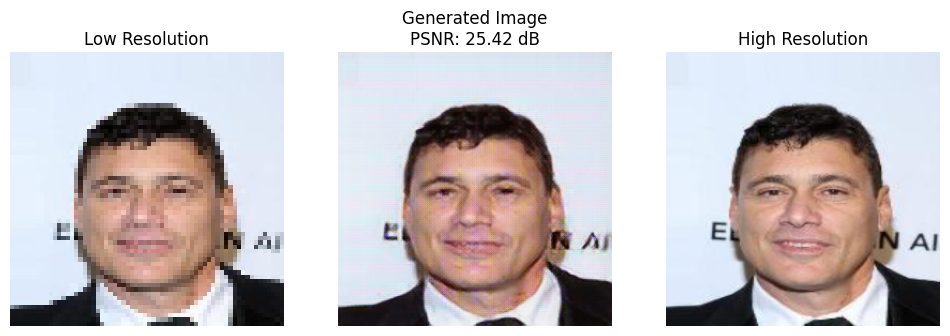


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_50.h5 and /kaggle/working/models/discriminator_epoch_50.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9257 - adversarial_loss: 1.3512 - d_loss: 7.2215e-05 - gen_loss: 0.9271
Epoch 56/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9240 - adversarial_loss: 1.2210 - d_loss: 2.9838e-05 - gen_loss: 0.9252
Epoch 57/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9195 - adversarial_loss: 0.9447 - d_loss: 0.0473 - gen_loss: 0.9205
Epoch 58/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9198 - adversarial_loss: 1.3374 - d_loss: 0.0043 - gen_loss: 0.9212
Epoch 59/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9174 - adversarial_loss: 0.3542 - d_loss: 8.5004e-05 - gen_loss: 0.9177
Epoch 60/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9160 - adversarial_loss: 0.3278 - d_loss: 6.0193e-05 - gen_lo

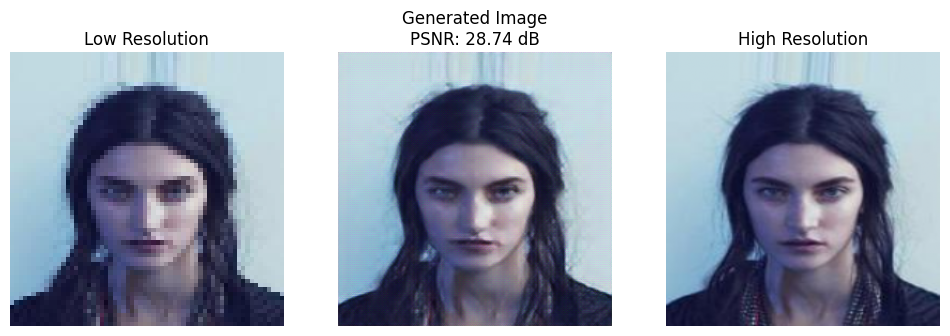


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_55.h5 and /kaggle/working/models/discriminator_epoch_55.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9160 - adversarial_loss: 0.3277 - d_loss: 6.0093e-05 - gen_loss: 0.9163
Epoch 61/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9153 - adversarial_loss: 0.2491 - d_loss: 4.5895e-05 - gen_loss: 0.9155
Epoch 62/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9120 - adversarial_loss: 0.1754 - d_loss: 4.5888e-05 - gen_loss: 0.9122
Epoch 63/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9080 - adversarial_loss: 0.2022 - d_loss: 3.1380e-05 - gen_loss: 0.9082
Epoch 64/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9073 - adversarial_loss: 0.1930 - d_loss: 2.3471e-05 - gen_loss: 0.9075
Epoch 65/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9069 - adversarial_loss: 0.1871 - d_loss: 2.6332e-05 

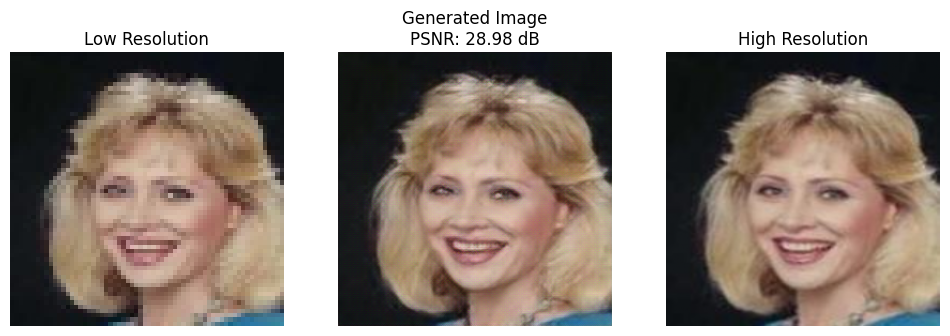


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_60.h5 and /kaggle/working/models/discriminator_epoch_60.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9072 - adversarial_loss: 0.1870 - d_loss: 2.6258e-05 - gen_loss: 0.9074
Epoch 66/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9066 - adversarial_loss: 0.1528 - d_loss: 2.1224e-05 - gen_loss: 0.9067
Epoch 67/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9056 - adversarial_loss: 0.1535 - d_loss: 2.2211e-05 - gen_loss: 0.9057
Epoch 68/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9046 - adversarial_loss: 0.2254 - d_loss: 2.4376e-05 - gen_loss: 0.9048
Epoch 69/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.9034 - adversarial_loss: 0.2743 - d_loss: 2.3273e-05 - gen_loss: 0.9037
Epoch 70/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.9003 - adversarial_loss: 0.1624 - d_loss: 1.2366e-05 

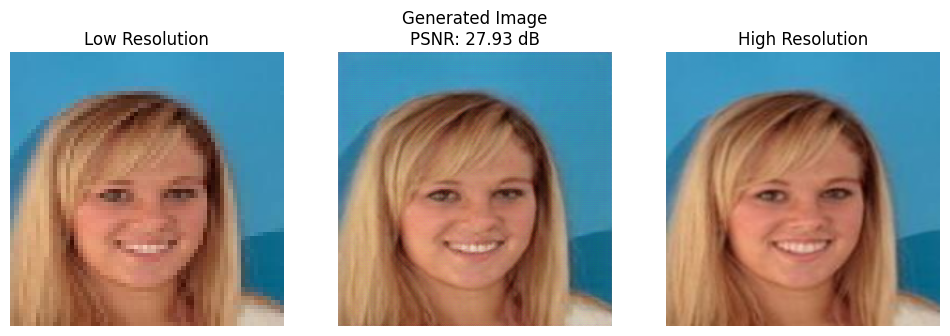


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_65.h5 and /kaggle/working/models/discriminator_epoch_65.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.9003 - adversarial_loss: 0.1627 - d_loss: 1.2339e-05 - gen_loss: 0.9004
Epoch 71/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8981 - adversarial_loss: 0.1990 - d_loss: 1.4599e-05 - gen_loss: 0.8983
Epoch 72/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8970 - adversarial_loss: 0.1429 - d_loss: 8.2215e-06 - gen_loss: 0.8971
Epoch 73/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8938 - adversarial_loss: 0.1654 - d_loss: 5.6743e-06 - gen_loss: 0.8939
Epoch 74/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8938 - adversarial_loss: 0.1153 - d_loss: 5.5073e-06 - gen_loss: 0.8939
Epoch 75/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8942 - adversarial_loss: 0.1190 - d_loss: 3.9811e-06 

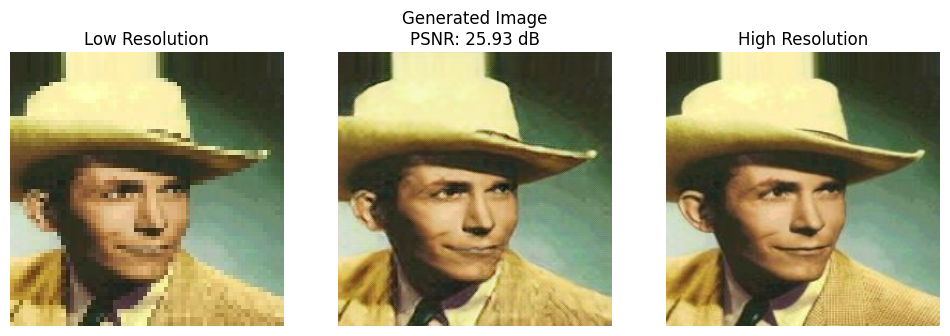


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_70.h5 and /kaggle/working/models/discriminator_epoch_70.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8941 - adversarial_loss: 0.1191 - d_loss: 4.0172e-06 - gen_loss: 0.8942
Epoch 76/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8919 - adversarial_loss: 0.2977 - d_loss: 6.9078e-06 - gen_loss: 0.8922
Epoch 77/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8894 - adversarial_loss: 0.3475 - d_loss: 0.0193 - gen_loss: 0.8897
Epoch 78/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8874 - adversarial_loss: 0.1566 - d_loss: 1.8723e-04 - gen_loss: 0.8876
Epoch 79/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8874 - adversarial_loss: 0.1083 - d_loss: 6.0018e-05 - gen_loss: 0.8875
Epoch 80/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8870 - adversarial_loss: 0.0975 - d_loss: 3.9141e-05 - ge

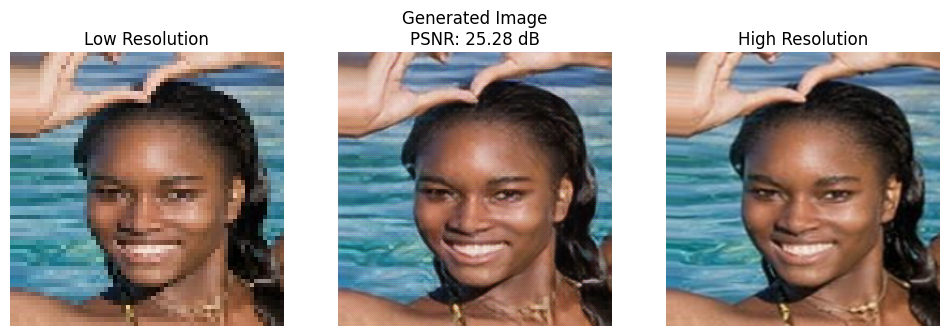


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_75.h5 and /kaggle/working/models/discriminator_epoch_75.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8871 - adversarial_loss: 0.0973 - d_loss: 3.9064e-05 - gen_loss: 0.8872
Epoch 81/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8835 - adversarial_loss: 0.2780 - d_loss: 4.5357e-05 - gen_loss: 0.8838
Epoch 82/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8838 - adversarial_loss: 0.3524 - d_loss: 2.6517e-05 - gen_loss: 0.8841
Epoch 83/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8818 - adversarial_loss: 0.3187 - d_loss: 2.1987e-05 - gen_loss: 0.8822
Epoch 84/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8809 - adversarial_loss: 0.2325 - d_loss: 3.0855e-05 - gen_loss: 0.8811
Epoch 85/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8810 - adversarial_loss: 0.2215 - d_loss: 1.5539e-05 

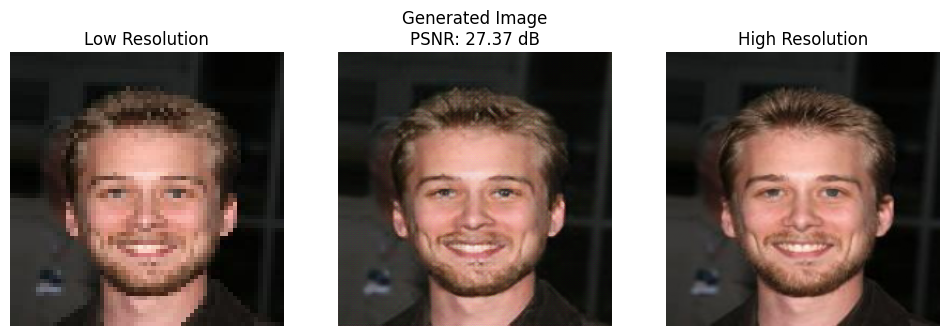


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_80.h5 and /kaggle/working/models/discriminator_epoch_80.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8813 - adversarial_loss: 0.2219 - d_loss: 1.5523e-05 - gen_loss: 0.8816
Epoch 86/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8798 - adversarial_loss: 0.3067 - d_loss: 1.5709e-05 - gen_loss: 0.8801
Epoch 87/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8754 - adversarial_loss: 0.3404 - d_loss: 1.3082e-05 - gen_loss: 0.8757
Epoch 88/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8762 - adversarial_loss: 0.4713 - d_loss: 1.5789e-05 - gen_loss: 0.8767
Epoch 89/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8748 - adversarial_loss: 0.6619 - d_loss: 0.0346 - gen_loss: 0.8754
Epoch 90/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8738 - adversarial_loss: 0.5436 - d_loss: 2.1277e-04 - ge

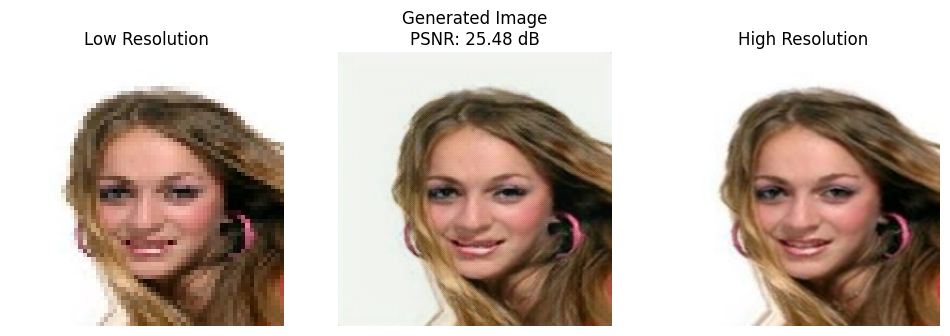


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_85.h5 and /kaggle/working/models/discriminator_epoch_85.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8738 - adversarial_loss: 0.5431 - d_loss: 2.1215e-04 - gen_loss: 0.8744
Epoch 91/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8719 - adversarial_loss: 0.3794 - d_loss: 6.4171e-05 - gen_loss: 0.8723
Epoch 92/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8715 - adversarial_loss: 0.3875 - d_loss: 5.9824e-05 - gen_loss: 0.8719
Epoch 93/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8700 - adversarial_loss: 0.3391 - d_loss: 5.0587e-05 - gen_loss: 0.8704
Epoch 94/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8692 - adversarial_loss: 0.3656 - d_loss: 3.1114e-05 - gen_loss: 0.8696
Epoch 95/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8678 - adversarial_loss: 0.4893 - d_loss: 5.0388e-05 

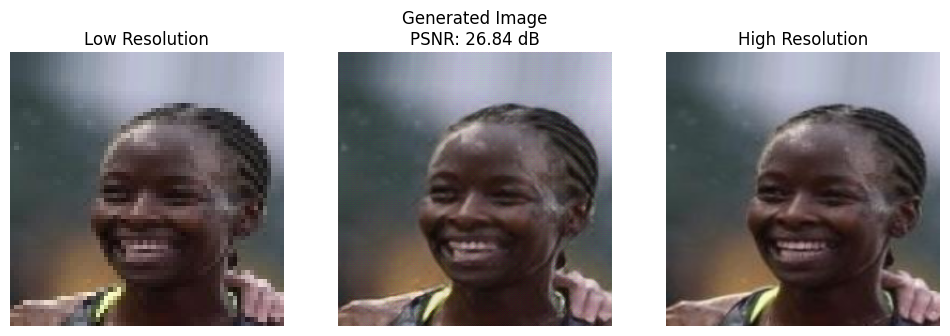


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_90.h5 and /kaggle/working/models/discriminator_epoch_90.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8680 - adversarial_loss: 0.4891 - d_loss: 5.0250e-05 - gen_loss: 0.8685
Epoch 96/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8662 - adversarial_loss: 0.4170 - d_loss: 1.9629e-05 - gen_loss: 0.8666
Epoch 97/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8656 - adversarial_loss: 0.3676 - d_loss: 1.8357e-05 - gen_loss: 0.8660
Epoch 98/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 142s 410ms/step - Content_loss: 0.8616 - adversarial_loss: 0.3251 - d_loss: 1.4005e-05 - gen_loss: 0.8619
Epoch 99/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8633 - adversarial_loss: 0.3504 - d_loss: 1.1186e-05 - gen_loss: 0.8637
Epoch 100/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8621 - adversarial_loss: 0.3600 - d_loss: 9.3650e-06

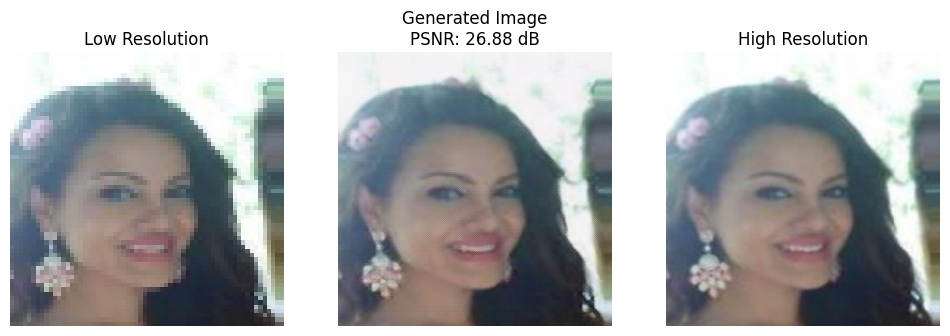


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_95.h5 and /kaggle/working/models/discriminator_epoch_95.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8623 - adversarial_loss: 0.3597 - d_loss: 9.3611e-06 - gen_loss: 0.8626
Epoch 101/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8603 - adversarial_loss: 0.3492 - d_loss: 7.9142e-06 - gen_loss: 0.8607
Epoch 102/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8607 - adversarial_loss: 0.2988 - d_loss: 1.3770e-05 - gen_loss: 0.8610
Epoch 103/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8571 - adversarial_loss: 0.2183 - d_loss: 2.3751e-06 - gen_loss: 0.8573
Epoch 104/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8573 - adversarial_loss: 0.2238 - d_loss: 2.8405e-06 - gen_loss: 0.8575
Epoch 105/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8562 - adversarial_loss: 0.2213 - d_loss: 2.2851

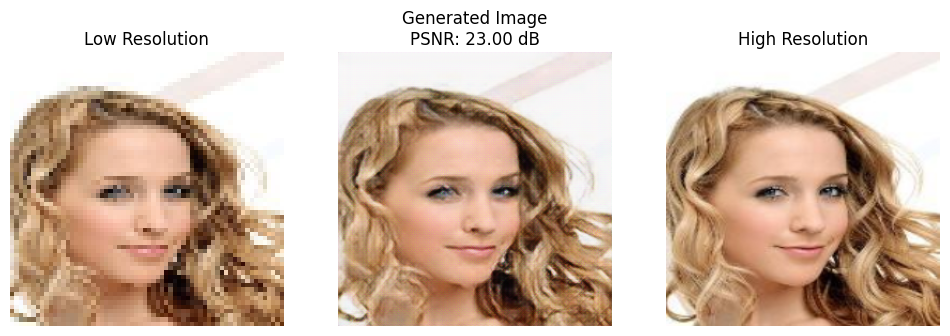


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_100.h5 and /kaggle/working/models/discriminator_epoch_100.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8563 - adversarial_loss: 0.2214 - d_loss: 2.2796e-06 - gen_loss: 0.8565
Epoch 106/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8546 - adversarial_loss: 1.3115 - d_loss: 0.0010 - gen_loss: 0.8560
Epoch 107/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8552 - adversarial_loss: 0.6127 - d_loss: 1.9564e-06 - gen_loss: 0.8558
Epoch 108/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8523 - adversarial_loss: 0.5515 - d_loss: 2.1383e-06 - gen_loss: 0.8528
Epoch 109/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8527 - adversarial_loss: 0.5019 - d_loss: 1.8976e-06 - gen_loss: 0.8532
Epoch 110/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8511 - adversarial_loss: 0.5347 - d_loss: 3.1466e-

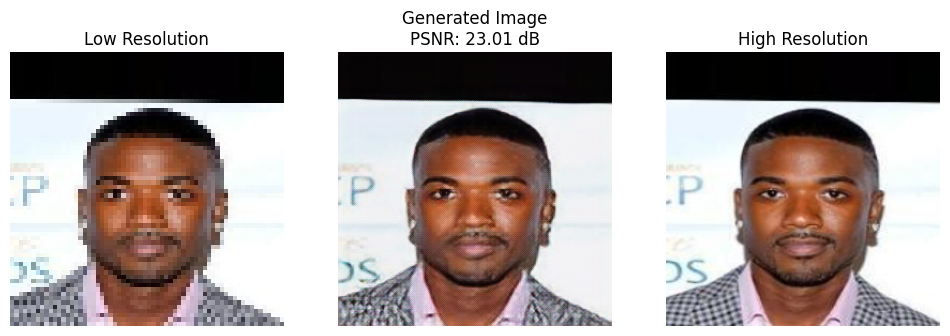


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_105.h5 and /kaggle/working/models/discriminator_epoch_105.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8515 - adversarial_loss: 0.5347 - d_loss: 3.1366e-06 - gen_loss: 0.8520
Epoch 111/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8519 - adversarial_loss: 0.4339 - d_loss: 8.8146e-07 - gen_loss: 0.8523
Epoch 112/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8490 - adversarial_loss: 0.4099 - d_loss: 2.4969e-06 - gen_loss: 0.8494
Epoch 113/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8475 - adversarial_loss: 0.4613 - d_loss: 2.1112e-06 - gen_loss: 0.8479
Epoch 114/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8489 - adversarial_loss: 0.8356 - d_loss: 6.3634e-06 - gen_loss: 0.8497
Epoch 115/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8470 - adversarial_loss: 1.0587 - d_loss: 7.08

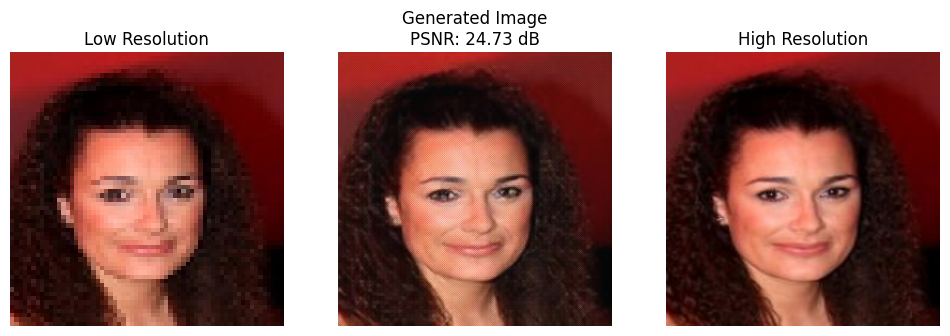


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_110.h5 and /kaggle/working/models/discriminator_epoch_110.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8474 - adversarial_loss: 1.0582 - d_loss: 7.2473e-07 - gen_loss: 0.8484
Epoch 116/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8457 - adversarial_loss: 0.4677 - d_loss: 1.1419e-05 - gen_loss: 0.8462
Epoch 117/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8448 - adversarial_loss: 0.0692 - d_loss: 3.5139e-07 - gen_loss: 0.8449
Epoch 118/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.8448 - adversarial_loss: 0.1127 - d_loss: 1.3029e-07 - gen_loss: 0.8449
Epoch 119/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8427 - adversarial_loss: 0.1237 - d_loss: 1.6452e-07 - gen_loss: 0.8429
Epoch 120/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8416 - adversarial_loss: 0.1403 - d_loss: 1.55

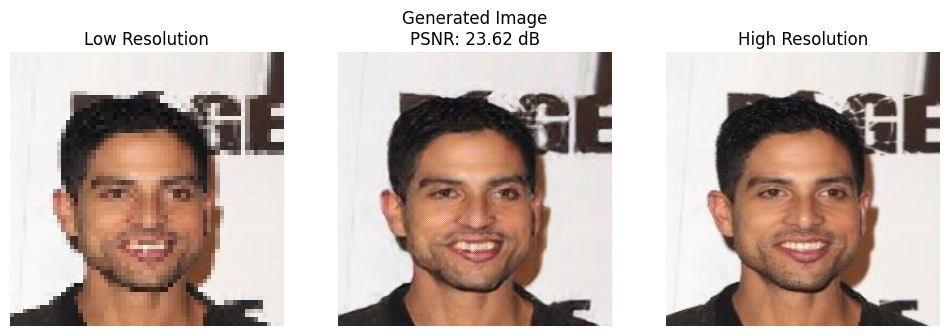


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_115.h5 and /kaggle/working/models/discriminator_epoch_115.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 130s 414ms/step - Content_loss: 0.8414 - adversarial_loss: 0.1402 - d_loss: 1.5502e-07 - gen_loss: 0.8415
Epoch 121/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8409 - adversarial_loss: 0.1732 - d_loss: 1.1581e-07 - gen_loss: 0.8410
Epoch 122/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8402 - adversarial_loss: 0.1727 - d_loss: 1.0099e-07 - gen_loss: 0.8404
Epoch 123/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8378 - adversarial_loss: 0.1857 - d_loss: 7.6067e-08 - gen_loss: 0.8380
Epoch 124/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8366 - adversarial_loss: 0.2012 - d_loss: 7.5516e-08 - gen_loss: 0.8368
Epoch 125/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8357 - adversarial_loss: 0.2117 - d_loss: 1.15

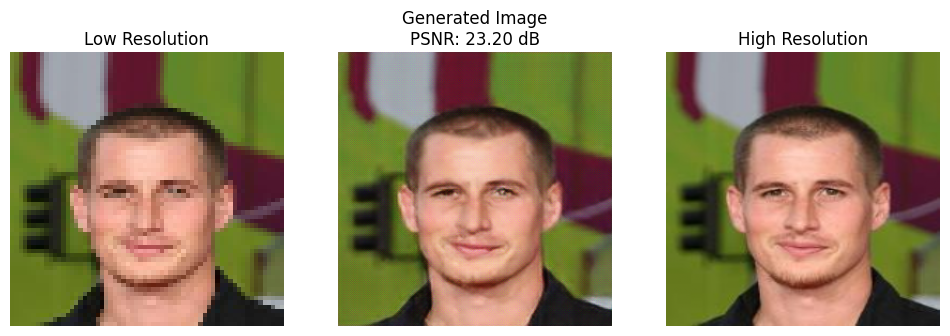


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_120.h5 and /kaggle/working/models/discriminator_epoch_120.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 414ms/step - Content_loss: 0.8356 - adversarial_loss: 0.2116 - d_loss: 1.1549e-07 - gen_loss: 0.8359
Epoch 126/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8384 - adversarial_loss: 0.2073 - d_loss: 9.7025e-08 - gen_loss: 0.8386
Epoch 127/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8372 - adversarial_loss: 0.2103 - d_loss: 1.2563e-07 - gen_loss: 0.8374
Epoch 128/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8351 - adversarial_loss: 0.2204 - d_loss: 7.3247e-08 - gen_loss: 0.8353
Epoch 129/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8330 - adversarial_loss: 0.2094 - d_loss: 8.3338e-08 - gen_loss: 0.8332
Epoch 130/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8329 - adversarial_loss: 0.2200 - d_loss: 5.25

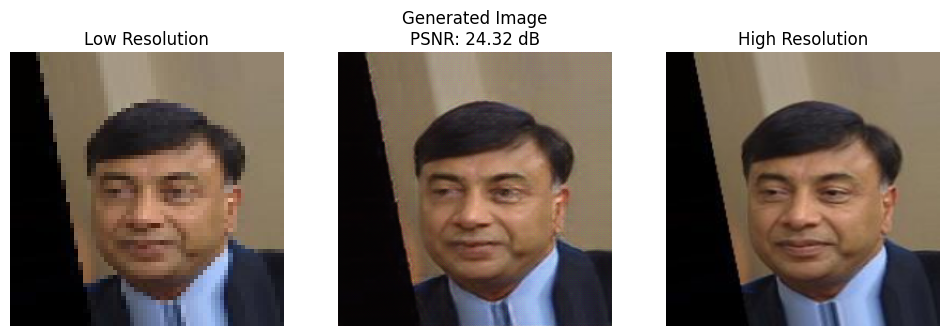


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_125.h5 and /kaggle/working/models/discriminator_epoch_125.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8331 - adversarial_loss: 0.2205 - d_loss: 5.2440e-08 - gen_loss: 0.8333
Epoch 131/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8336 - adversarial_loss: 0.2564 - d_loss: 8.6984e-08 - gen_loss: 0.8339
Epoch 132/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8313 - adversarial_loss: 1.8333 - d_loss: 0.0188 - gen_loss: 0.8332
Epoch 133/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8322 - adversarial_loss: 1.3272 - d_loss: 5.5707e-04 - gen_loss: 0.8335
Epoch 134/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8291 - adversarial_loss: 0.7408 - d_loss: 2.2899e-05 - gen_loss: 0.8298
Epoch 135/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8282 - adversarial_loss: 0.8845 - d_loss: 3.9473e-

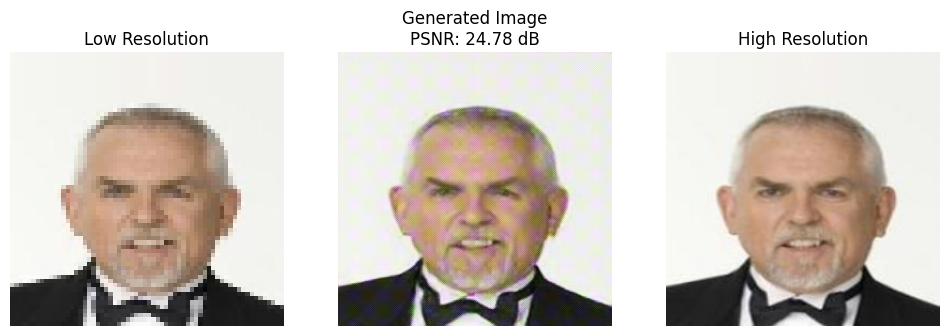


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_130.h5 and /kaggle/working/models/discriminator_epoch_130.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 414ms/step - Content_loss: 0.8284 - adversarial_loss: 0.8848 - d_loss: 3.9352e-04 - gen_loss: 0.8292
Epoch 136/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8279 - adversarial_loss: 1.2623 - d_loss: 6.8185e-04 - gen_loss: 0.8292
Epoch 137/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8277 - adversarial_loss: 1.9158 - d_loss: 6.2616e-04 - gen_loss: 0.8297
Epoch 138/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8264 - adversarial_loss: 1.0179 - d_loss: 0.0199 - gen_loss: 0.8274
Epoch 139/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8254 - adversarial_loss: 0.3093 - d_loss: 2.4897e-05 - gen_loss: 0.8257
Epoch 140/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8241 - adversarial_loss: 0.2940 - d_loss: 2.5537e-

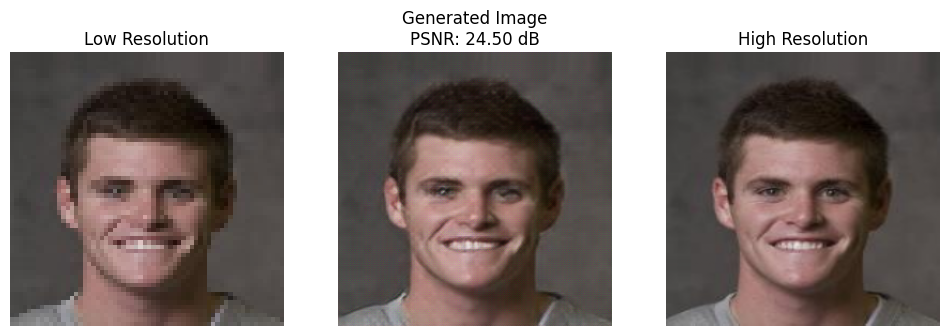


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_135.h5 and /kaggle/working/models/discriminator_epoch_135.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 414ms/step - Content_loss: 0.8241 - adversarial_loss: 0.2938 - d_loss: 2.5514e-05 - gen_loss: 0.8244
Epoch 141/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8237 - adversarial_loss: 0.2712 - d_loss: 4.2012e-05 - gen_loss: 0.8239
Epoch 142/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8249 - adversarial_loss: 0.2938 - d_loss: 1.0502e-05 - gen_loss: 0.8252
Epoch 143/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8233 - adversarial_loss: 0.2817 - d_loss: 7.6972e-06 - gen_loss: 0.8236
Epoch 144/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8214 - adversarial_loss: 0.6399 - d_loss: 1.9216e-04 - gen_loss: 0.8221
Epoch 145/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8211 - adversarial_loss: 1.1396 - d_loss: 3.56

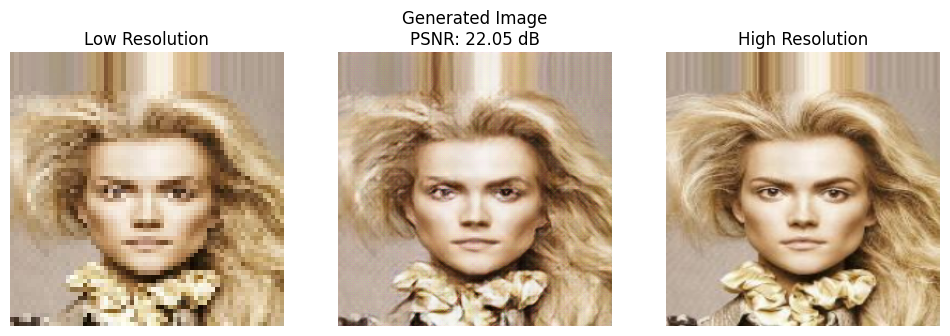


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_140.h5 and /kaggle/working/models/discriminator_epoch_140.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8212 - adversarial_loss: 1.1387 - d_loss: 3.5536e-05 - gen_loss: 0.8223
Epoch 146/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8200 - adversarial_loss: 0.7771 - d_loss: 2.2199e-05 - gen_loss: 0.8208
Epoch 147/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8218 - adversarial_loss: 0.7607 - d_loss: 3.4981e-05 - gen_loss: 0.8225
Epoch 148/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8199 - adversarial_loss: 0.7834 - d_loss: 2.4212e-05 - gen_loss: 0.8207
Epoch 149/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8181 - adversarial_loss: 0.6915 - d_loss: 1.8148e-04 - gen_loss: 0.8188
Epoch 150/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8177 - adversarial_loss: 0.3275 - d_loss: 0.00

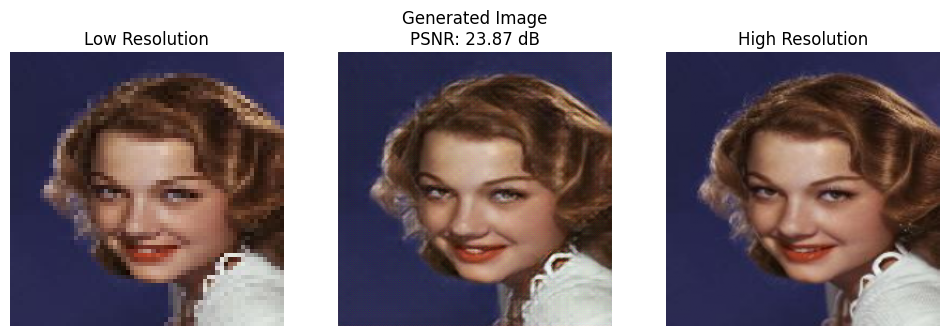


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_145.h5 and /kaggle/working/models/discriminator_epoch_145.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8180 - adversarial_loss: 0.3276 - d_loss: 0.0010 - gen_loss: 0.8183
Epoch 151/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8180 - adversarial_loss: 0.2852 - d_loss: 1.7415e-05 - gen_loss: 0.8183
Epoch 152/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8155 - adversarial_loss: 0.1347 - d_loss: 6.6074e-06 - gen_loss: 0.8156
Epoch 153/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8155 - adversarial_loss: 0.1549 - d_loss: 2.1130e-06 - gen_loss: 0.8157
Epoch 154/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8135 - adversarial_loss: 0.1686 - d_loss: 1.8918e-06 - gen_loss: 0.8136
Epoch 155/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8153 - adversarial_loss: 0.1921 - d_loss: 7.4951e-

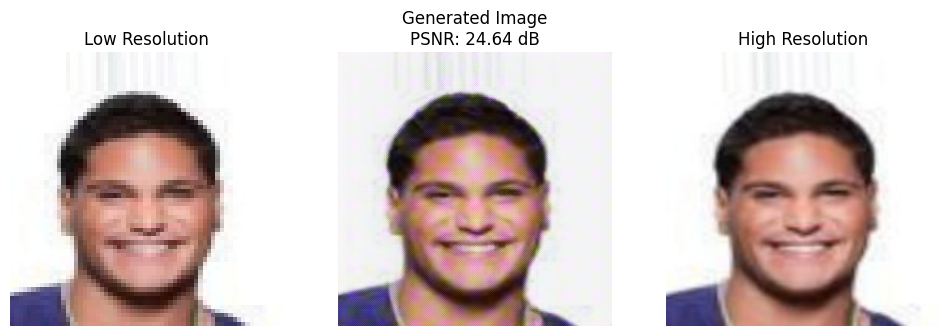


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_150.h5 and /kaggle/working/models/discriminator_epoch_150.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 414ms/step - Content_loss: 0.8150 - adversarial_loss: 0.1925 - d_loss: 7.4714e-06 - gen_loss: 0.8152
Epoch 156/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8136 - adversarial_loss: 0.2121 - d_loss: 0.0023 - gen_loss: 0.8138
Epoch 157/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8115 - adversarial_loss: 0.5351 - d_loss: 1.9399e-05 - gen_loss: 0.8120
Epoch 158/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 410ms/step - Content_loss: 0.8137 - adversarial_loss: 0.6521 - d_loss: 3.3293e-07 - gen_loss: 0.8143
Epoch 159/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8114 - adversarial_loss: 0.4963 - d_loss: 6.4915e-07 - gen_loss: 0.8119
Epoch 160/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8106 - adversarial_loss: 0.4660 - d_loss: 3.0061e-

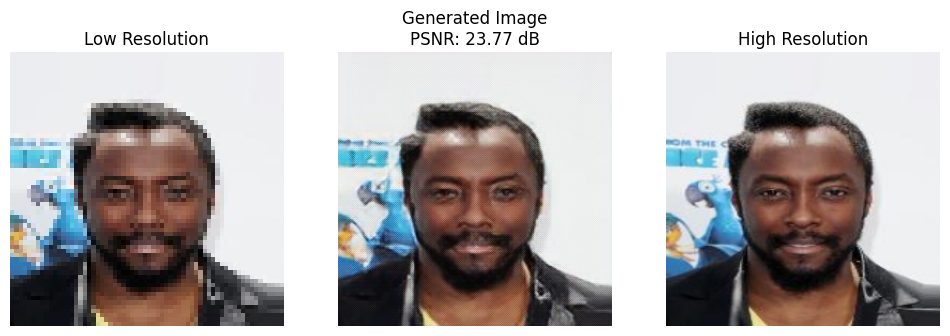


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_155.h5 and /kaggle/working/models/discriminator_epoch_155.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8105 - adversarial_loss: 0.4660 - d_loss: 2.9975e-07 - gen_loss: 0.8110
Epoch 161/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8096 - adversarial_loss: 0.4514 - d_loss: 7.7517e-07 - gen_loss: 0.8100
Epoch 162/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8086 - adversarial_loss: 0.4268 - d_loss: 1.2477e-06 - gen_loss: 0.8091
Epoch 163/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8100 - adversarial_loss: 0.3702 - d_loss: 8.8860e-07 - gen_loss: 0.8103
Epoch 164/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.8075 - adversarial_loss: 0.3664 - d_loss: 5.1139e-07 - gen_loss: 0.8079
Epoch 165/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8081 - adversarial_loss: 0.3995 - d_loss: 1.07

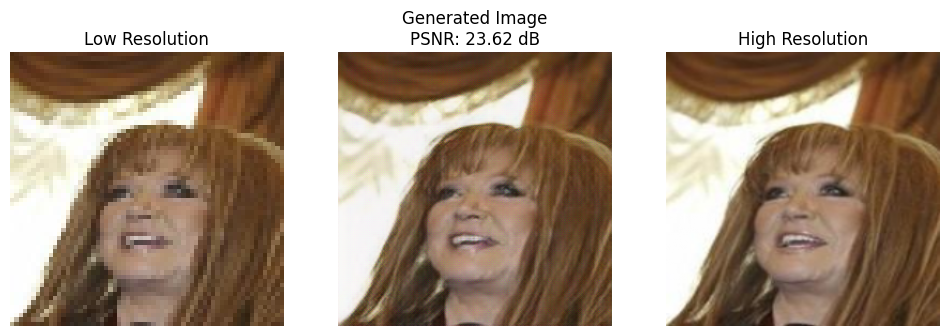


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_160.h5 and /kaggle/working/models/discriminator_epoch_160.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8080 - adversarial_loss: 0.3996 - d_loss: 1.0689e-06 - gen_loss: 0.8084
Epoch 166/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8058 - adversarial_loss: 0.4180 - d_loss: 7.2441e-07 - gen_loss: 0.8062
Epoch 167/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8075 - adversarial_loss: 0.4257 - d_loss: 7.7594e-07 - gen_loss: 0.8079
Epoch 168/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8055 - adversarial_loss: 0.4435 - d_loss: 4.1297e-07 - gen_loss: 0.8060
Epoch 169/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8041 - adversarial_loss: 0.4495 - d_loss: 6.9431e-07 - gen_loss: 0.8046
Epoch 170/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8042 - adversarial_loss: 0.4813 - d_loss: 5.84

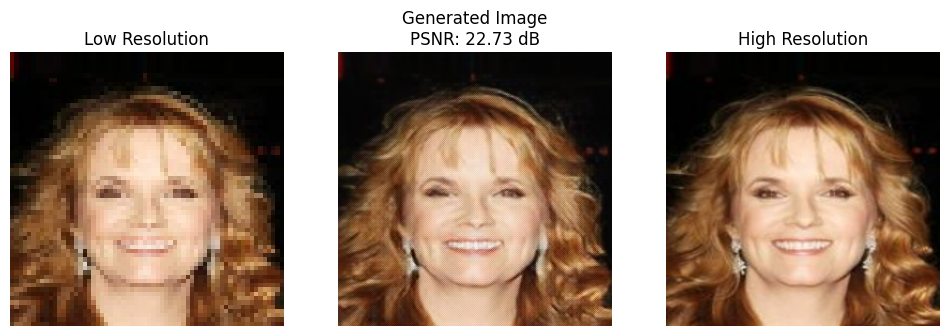


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_165.h5 and /kaggle/working/models/discriminator_epoch_165.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 412ms/step - Content_loss: 0.8042 - adversarial_loss: 0.4806 - d_loss: 5.8676e-07 - gen_loss: 0.8047
Epoch 171/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8045 - adversarial_loss: 0.4741 - d_loss: 3.6600e-07 - gen_loss: 0.8049
Epoch 172/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8044 - adversarial_loss: 0.5699 - d_loss: 0.0084 - gen_loss: 0.8050
Epoch 173/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8029 - adversarial_loss: 0.2429 - d_loss: 3.8649e-06 - gen_loss: 0.8031
Epoch 174/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8020 - adversarial_loss: 0.2218 - d_loss: 2.2190e-06 - gen_loss: 0.8022
Epoch 175/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.8015 - adversarial_loss: 0.2126 - d_loss: 1.1370e-

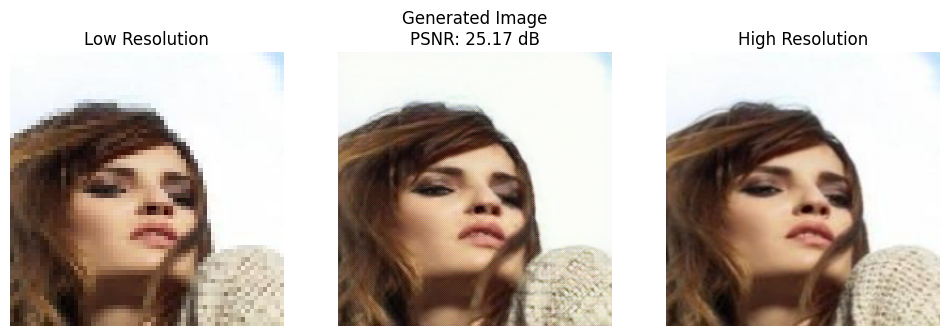


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_170.h5 and /kaggle/working/models/discriminator_epoch_170.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.8018 - adversarial_loss: 0.2128 - d_loss: 1.1334e-05 - gen_loss: 0.8020
Epoch 176/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.8017 - adversarial_loss: 0.2176 - d_loss: 6.8884e-07 - gen_loss: 0.8019
Epoch 177/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7992 - adversarial_loss: 0.1960 - d_loss: 8.1310e-07 - gen_loss: 0.7994
Epoch 178/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7995 - adversarial_loss: 0.1775 - d_loss: 1.7878e-06 - gen_loss: 0.7997
Epoch 180/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7987 - adversarial_loss: 0.1675 - d_loss: 6.2615e-07 - gen_loss: 0.7989

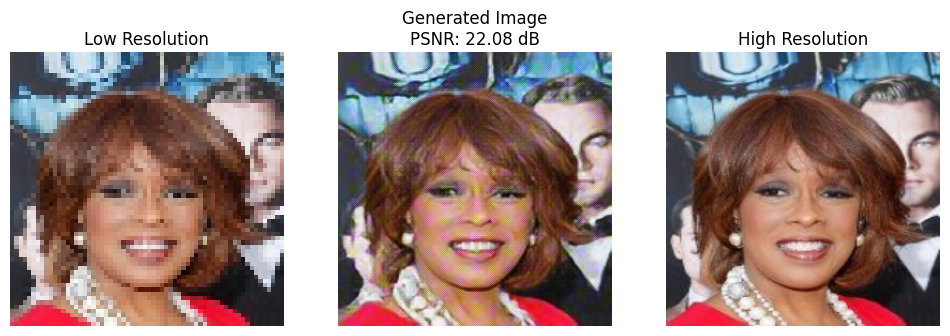


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_175.h5 and /kaggle/working/models/discriminator_epoch_175.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7988 - adversarial_loss: 0.1675 - d_loss: 6.2420e-07 - gen_loss: 0.7990
Epoch 181/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7973 - adversarial_loss: 0.1645 - d_loss: 9.1282e-07 - gen_loss: 0.7974
Epoch 182/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7979 - adversarial_loss: 0.1681 - d_loss: 1.3749e-06 - gen_loss: 0.7980
Epoch 183/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7964 - adversarial_loss: 0.1677 - d_loss: 4.5917e-07 - gen_loss: 0.7965
Epoch 184/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7964 - adversarial_loss: 0.1584 - d_loss: 2.7895e-07 - gen_loss: 0.7965
Epoch 185/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7961 - adversarial_loss: 0.1700 - d_loss: 3.82

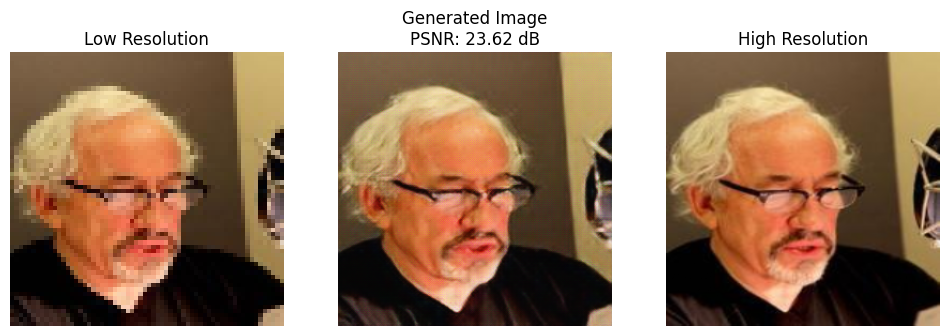


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_180.h5 and /kaggle/working/models/discriminator_epoch_180.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7961 - adversarial_loss: 0.1700 - d_loss: 3.8188e-07 - gen_loss: 0.7963
Epoch 186/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7957 - adversarial_loss: 0.1601 - d_loss: 4.4352e-07 - gen_loss: 0.7959
Epoch 187/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7950 - adversarial_loss: 0.1691 - d_loss: 5.1901e-07 - gen_loss: 0.7952
Epoch 188/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7952 - adversarial_loss: 0.1746 - d_loss: 2.1304e-06 - gen_loss: 0.7953
Epoch 189/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7935 - adversarial_loss: 0.1837 - d_loss: 1.1573e-07 - gen_loss: 0.7937
Epoch 190/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7925 - adversarial_loss: 0.1881 - d_loss: 3.02

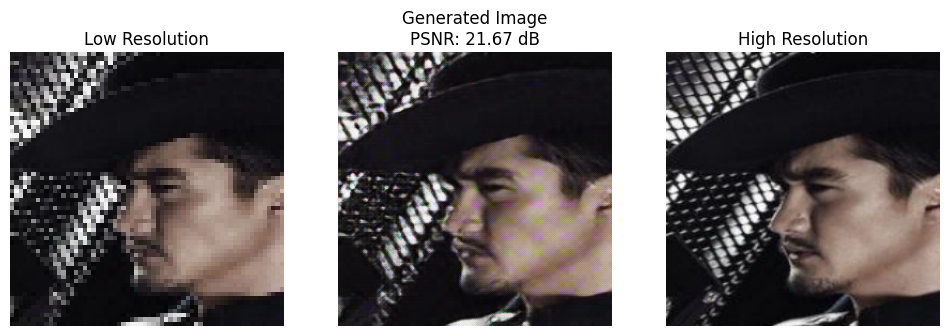


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_185.h5 and /kaggle/working/models/discriminator_epoch_185.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7924 - adversarial_loss: 0.1881 - d_loss: 3.0139e-07 - gen_loss: 0.7926
Epoch 191/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7941 - adversarial_loss: 0.1841 - d_loss: 1.5307e-07 - gen_loss: 0.7943
Epoch 192/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7939 - adversarial_loss: 0.1970 - d_loss: 9.7167e-08 - gen_loss: 0.7941
Epoch 193/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7914 - adversarial_loss: 0.1906 - d_loss: 1.4490e-07 - gen_loss: 0.7916
Epoch 194/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7928 - adversarial_loss: 0.1894 - d_loss: 1.2424e-07 - gen_loss: 0.7930
Epoch 195/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7914 - adversarial_loss: 0.2083 - d_loss: 3.00

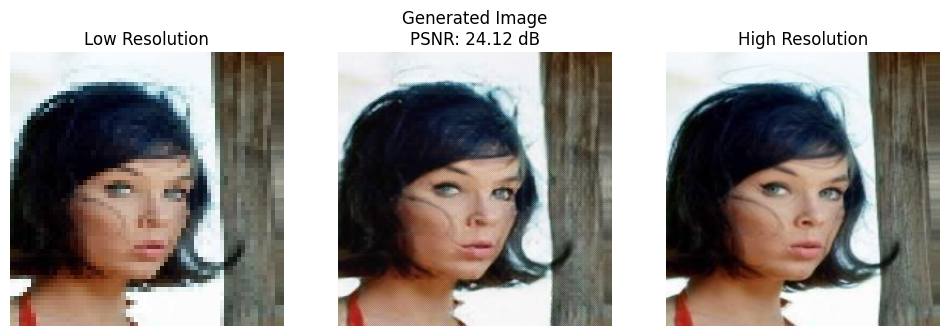


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_190.h5 and /kaggle/working/models/discriminator_epoch_190.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7917 - adversarial_loss: 0.2087 - d_loss: 3.0009e-07 - gen_loss: 0.7919
Epoch 196/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7901 - adversarial_loss: 0.2128 - d_loss: 9.3448e-08 - gen_loss: 0.7903
Epoch 197/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7904 - adversarial_loss: 0.2246 - d_loss: 1.0023e-07 - gen_loss: 0.7906
Epoch 198/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7889 - adversarial_loss: 0.2184 - d_loss: 5.6812e-08 - gen_loss: 0.7891
Epoch 199/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7897 - adversarial_loss: 0.2378 - d_loss: 5.6652e-08 - gen_loss: 0.7900
Epoch 200/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7893 - adversarial_loss: 0.3142 - d_loss: 0.01

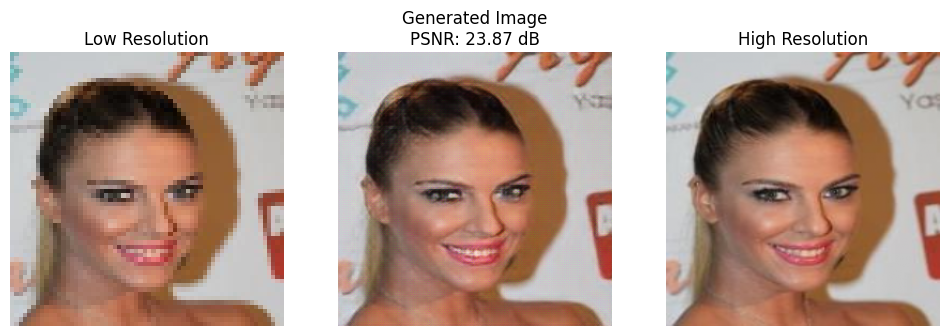


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_195.h5 and /kaggle/working/models/discriminator_epoch_195.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7894 - adversarial_loss: 0.3137 - d_loss: 0.0198 - gen_loss: 0.7897
Epoch 201/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7886 - adversarial_loss: 0.2155 - d_loss: 1.6380e-04 - gen_loss: 0.7889
Epoch 202/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7876 - adversarial_loss: 0.2435 - d_loss: 4.0582e-05 - gen_loss: 0.7879
Epoch 203/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7870 - adversarial_loss: 0.1606 - d_loss: 9.2106e-05 - gen_loss: 0.7872
Epoch 204/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7884 - adversarial_loss: 0.1482 - d_loss: 5.9454e-05 - gen_loss: 0.7886
Epoch 205/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7874 - adversarial_loss: 0.2299 - d_loss: 1.2432e-

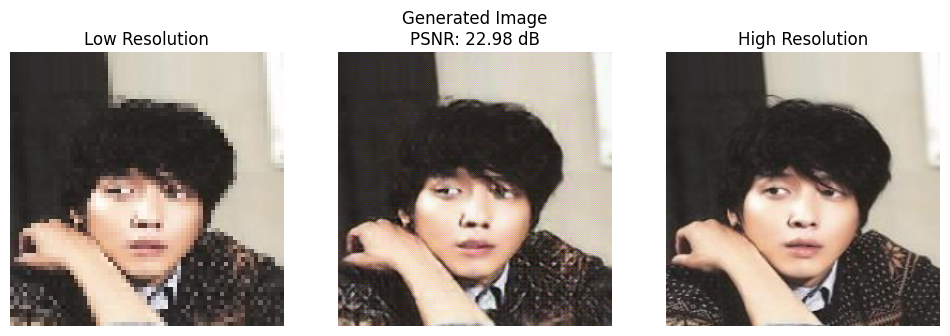


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_200.h5 and /kaggle/working/models/discriminator_epoch_200.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 414ms/step - Content_loss: 0.7872 - adversarial_loss: 0.2299 - d_loss: 1.2393e-05 - gen_loss: 0.7874
Epoch 206/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7855 - adversarial_loss: 0.2438 - d_loss: 6.3337e-06 - gen_loss: 0.7857
Epoch 207/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7854 - adversarial_loss: 0.2369 - d_loss: 8.6121e-06 - gen_loss: 0.7857
Epoch 208/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7846 - adversarial_loss: 0.2597 - d_loss: 6.1004e-06 - gen_loss: 0.7849
Epoch 209/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7854 - adversarial_loss: 0.2278 - d_loss: 6.4924e-06 - gen_loss: 0.7856
Epoch 210/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7847 - adversarial_loss: 0.2147 - d_loss: 2.63

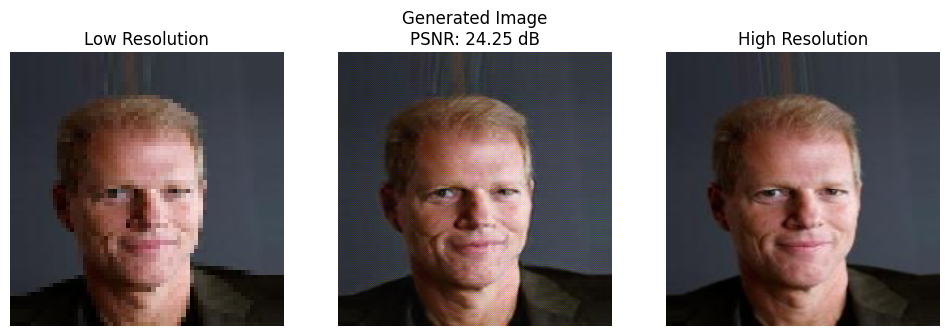


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_205.h5 and /kaggle/working/models/discriminator_epoch_205.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7848 - adversarial_loss: 0.2143 - d_loss: 2.6288e-06 - gen_loss: 0.7850
Epoch 211/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7835 - adversarial_loss: 0.2066 - d_loss: 3.0175e-06 - gen_loss: 0.7837
Epoch 212/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7829 - adversarial_loss: 0.2040 - d_loss: 2.6043e-06 - gen_loss: 0.7831
Epoch 213/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7842 - adversarial_loss: 0.2213 - d_loss: 3.5107e-06 - gen_loss: 0.7845
Epoch 214/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7822 - adversarial_loss: 0.1741 - d_loss: 1.9825e-05 - gen_loss: 0.7824
Epoch 215/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7821 - adversarial_loss: 0.0608 - d_loss: 3.24

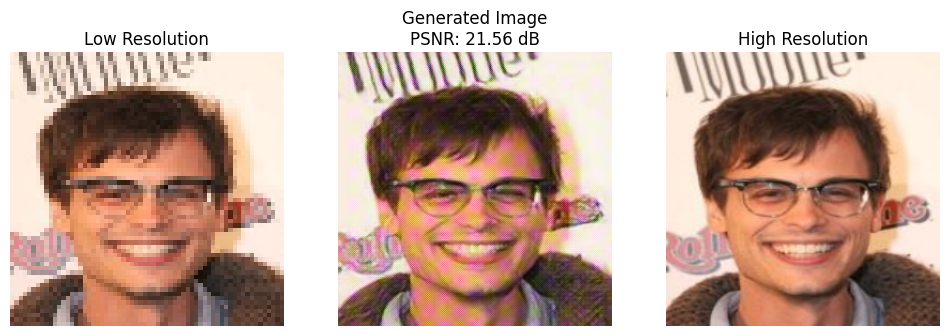


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_210.h5 and /kaggle/working/models/discriminator_epoch_210.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7823 - adversarial_loss: 0.0607 - d_loss: 3.2364e-06 - gen_loss: 0.7823
Epoch 216/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7810 - adversarial_loss: 0.0761 - d_loss: 7.9093e-07 - gen_loss: 0.7811
Epoch 217/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7809 - adversarial_loss: 0.0828 - d_loss: 6.3179e-07 - gen_loss: 0.7810
Epoch 218/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7806 - adversarial_loss: 0.0997 - d_loss: 2.2468e-06 - gen_loss: 0.7807
Epoch 219/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.7815 - adversarial_loss: 0.1245 - d_loss: 6.2894e-07 - gen_loss: 0.7817
Epoch 220/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7808 - adversarial_loss: 0.1623 - d_loss: 6.86

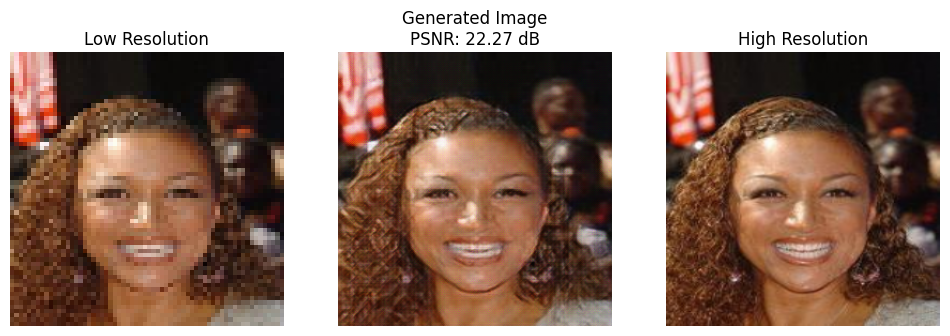


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_215.h5 and /kaggle/working/models/discriminator_epoch_215.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 412ms/step - Content_loss: 0.7809 - adversarial_loss: 0.1622 - d_loss: 6.8483e-07 - gen_loss: 0.7811
Epoch 221/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.7800 - adversarial_loss: 0.1550 - d_loss: 2.2158e-07 - gen_loss: 0.7801
Epoch 222/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7802 - adversarial_loss: 0.1782 - d_loss: 5.4160e-07 - gen_loss: 0.7804
Epoch 223/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.7783 - adversarial_loss: 0.1884 - d_loss: 4.2395e-07 - gen_loss: 0.7785
Epoch 224/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7775 - adversarial_loss: 0.1876 - d_loss: 6.9944e-07 - gen_loss: 0.7777
Epoch 225/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7783 - adversarial_loss: 0.1854 - d_loss: 1.48

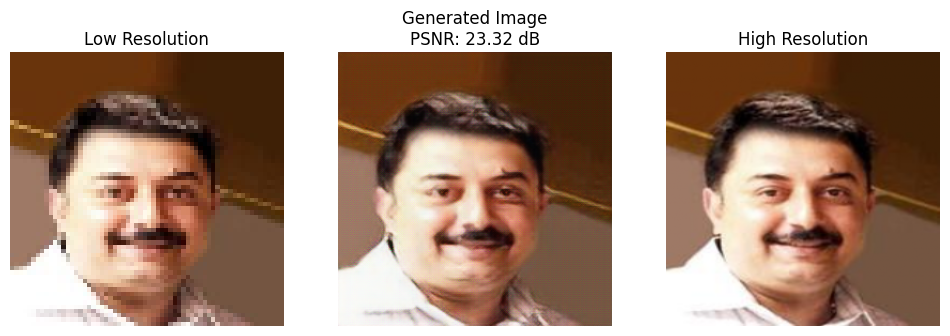


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_220.h5 and /kaggle/working/models/discriminator_epoch_220.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7781 - adversarial_loss: 0.1855 - d_loss: 1.4763e-07 - gen_loss: 0.7783
Epoch 226/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7776 - adversarial_loss: 0.2330 - d_loss: 6.1271e-07 - gen_loss: 0.7779
Epoch 227/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7772 - adversarial_loss: 0.3035 - d_loss: 1.6028e-07 - gen_loss: 0.7775
Epoch 228/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7773 - adversarial_loss: 0.5554 - d_loss: 1.5013e-06 - gen_loss: 0.7779
Epoch 229/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7772 - adversarial_loss: 0.5691 - d_loss: 1.2348e-07 - gen_loss: 0.7778
Epoch 230/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step - Content_loss: 0.7761 - adversarial_loss: 0.5333 - d_loss: 2.78

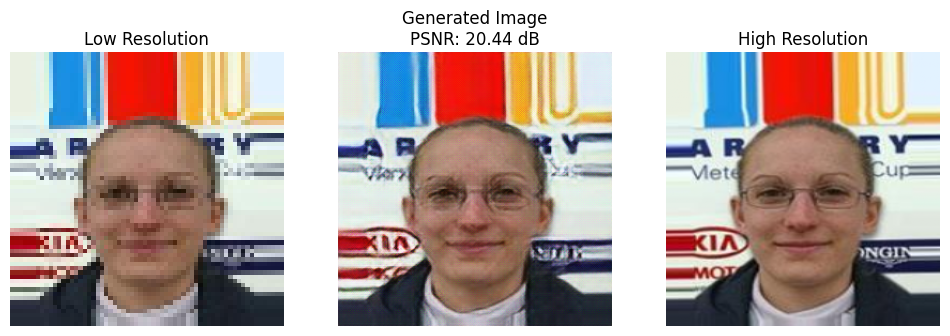


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_225.h5 and /kaggle/working/models/discriminator_epoch_225.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 412ms/step - Content_loss: 0.7763 - adversarial_loss: 0.5341 - d_loss: 2.7796e-07 - gen_loss: 0.7768
Epoch 231/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.7748 - adversarial_loss: 0.5569 - d_loss: 5.8781e-08 - gen_loss: 0.7754
Epoch 232/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7773 - adversarial_loss: 0.5769 - d_loss: 8.0195e-07 - gen_loss: 0.7779
Epoch 233/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7759 - adversarial_loss: 0.7350 - d_loss: 1.3210e-07 - gen_loss: 0.7766
Epoch 234/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.7743 - adversarial_loss: 0.5803 - d_loss: 6.8502e-08 - gen_loss: 0.7749
Epoch 235/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7731 - adversarial_loss: 0.5239 - d_loss: 1.02

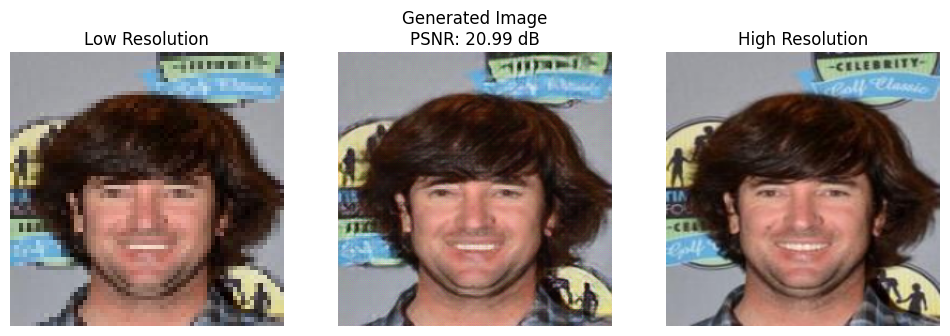


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_230.h5 and /kaggle/working/models/discriminator_epoch_230.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 412ms/step - Content_loss: 0.7731 - adversarial_loss: 0.5237 - d_loss: 1.0201e-07 - gen_loss: 0.7736
Epoch 236/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7743 - adversarial_loss: 0.4739 - d_loss: 3.6083e-08 - gen_loss: 0.7747
Epoch 237/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7746 - adversarial_loss: 0.3602 - d_loss: 9.5980e-08 - gen_loss: 0.7749
Epoch 238/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7742 - adversarial_loss: 0.2790 - d_loss: 1.7168e-08 - gen_loss: 0.7745
Epoch 239/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7709 - adversarial_loss: 0.2759 - d_loss: 3.8515e-08 - gen_loss: 0.7712
Epoch 240/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7727 - adversarial_loss: 0.2614 - d_loss: 3.45

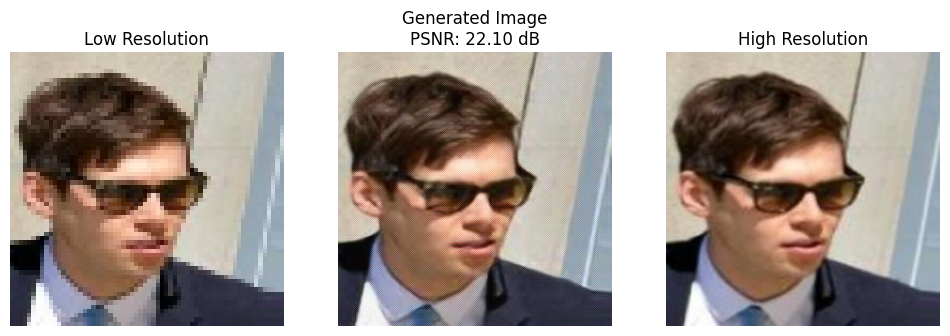


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_235.h5 and /kaggle/working/models/discriminator_epoch_235.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7727 - adversarial_loss: 0.2616 - d_loss: 3.4415e-08 - gen_loss: 0.7729
Epoch 241/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7711 - adversarial_loss: 0.2138 - d_loss: 2.0001e-08 - gen_loss: 0.7713
Epoch 242/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7707 - adversarial_loss: 0.1863 - d_loss: 3.6826e-08 - gen_loss: 0.7709
Epoch 243/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7709 - adversarial_loss: 0.1802 - d_loss: 1.2538e-08 - gen_loss: 0.7711
Epoch 244/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.7704 - adversarial_loss: 0.2073 - d_loss: 2.7676e-08 - gen_loss: 0.7706
Epoch 245/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7707 - adversarial_loss: 0.2356 - d_loss: 7.69

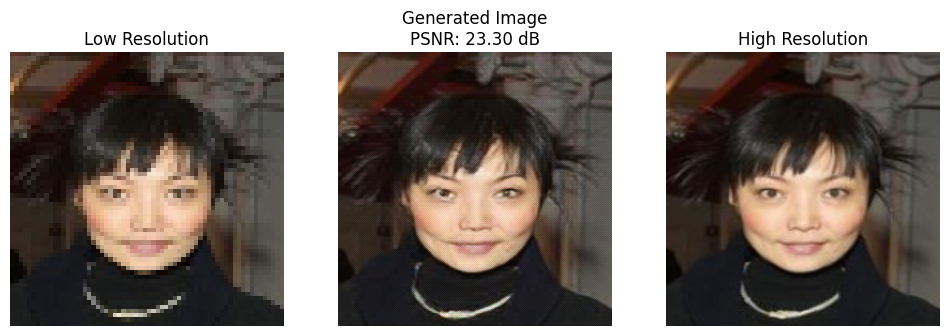


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_240.h5 and /kaggle/working/models/discriminator_epoch_240.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7708 - adversarial_loss: 0.2355 - d_loss: 7.6791e-09 - gen_loss: 0.7711
Epoch 246/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 408ms/step - Content_loss: 0.7708 - adversarial_loss: 0.2275 - d_loss: 1.1988e-08 - gen_loss: 0.7710
Epoch 247/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7710 - adversarial_loss: 0.1936 - d_loss: 4.5337e-09 - gen_loss: 0.7712
Epoch 248/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7707 - adversarial_loss: 0.1992 - d_loss: 2.9466e-08 - gen_loss: 0.7709
Epoch 249/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 128s 409ms/step - Content_loss: 0.7700 - adversarial_loss: 0.1951 - d_loss: 6.0729e-09 - gen_loss: 0.7702
Epoch 250/250
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - Content_loss: 0.7699 - adversarial_loss: 0.1893 - d_loss: 3.72

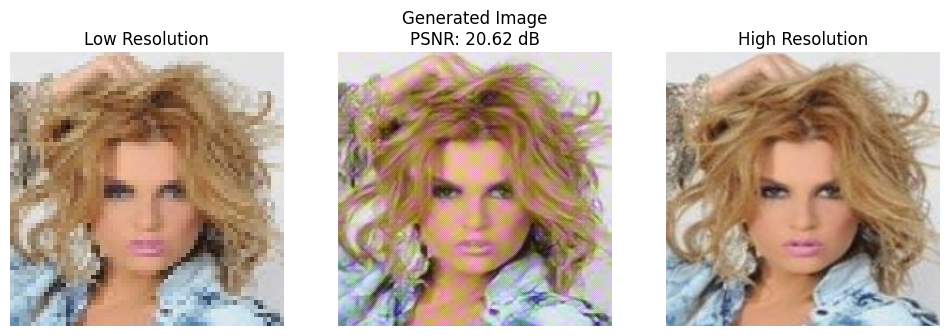


Saved checkpoints
Deleted previous checkpoint: /kaggle/working/models/generator_epoch_245.h5 and /kaggle/working/models/discriminator_epoch_245.h5
312/312 ━━━━━━━━━━━━━━━━━━━━ 129s 413ms/step - Content_loss: 0.7700 - adversarial_loss: 0.1892 - d_loss: 3.7323e-09 - gen_loss: 0.7702


In [21]:
# Instantiate and compile the GAN model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
srgan = SRGAN(generator, discriminator,vgg19_feature_extractor)

srgan.compile(
    generator_optimizer=Adam(learning_rate=2e-4, beta_1=0.5),
    discriminator_optimizer=Adam(learning_rate=2e-4, beta_1=0.5),
    loss_fn=BinaryCrossentropy(),
    content_loss_weight=1,
    adversarial_loss_weight=1e-3
)

# Train the GAN model using `fit`
srgan.fit(train_gen,epochs=250,callbacks=[GANMonitor(images_names=full_images,interval=5),Custom_CheckPoint()])